# Problem Statement:

- Houses are one of the necessary need of each and every person around the globe and therefore housing and real estate market is one of the markets which is one of the major contributors in the world’s economy. It is a very large market and there are various companies working in the domain. Data science comes as a very important tool to solve problems in the domain to help the companies increase their overall revenue, profits, improving their marketing strategies and focusing on changing trends in house sales and purchases. Predictive modelling, Market mix modelling, recommendation systems are some of the machine learning techniques used for achieving the business goals for housing companies. Our problem is related to one such housing company.

- A US-based housing company named Surprise Housing has decided to enter the Australian market. The company uses data analytics to purchase houses at a price below their actual values and flip them at a higher price. For the same purpose, the company has collected a data set from the sale of houses in Australia. The data is provided in the CSV file below.

- The company is looking at prospective properties to buy houses to enter the market. You are required to build a model using Machine Learning in order to predict the actual value of the prospective properties and decide whether to invest in them or not. For this company wants to know:

• Which variables are important to predict the price of variable?

• How do these variables describe the price of the house?


In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

In [2]:
df=pd.read_csv("train.csv")

In [3]:
df.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


In [4]:
pd.set_option('display.max_columns', None)
df.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


In [5]:
type(df)

pandas.core.frame.DataFrame

In [6]:
df.size

94608

In [7]:
df.shape

(1168, 81)

In [8]:
df.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1168 entries, 0 to 1167
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1168 non-null   int64  
 1   MSSubClass     1168 non-null   int64  
 2   MSZoning       1168 non-null   object 
 3   LotFrontage    954 non-null    float64
 4   LotArea        1168 non-null   int64  
 5   Street         1168 non-null   object 
 6   Alley          77 non-null     object 
 7   LotShape       1168 non-null   object 
 8   LandContour    1168 non-null   object 
 9   Utilities      1168 non-null   object 
 10  LotConfig      1168 non-null   object 
 11  LandSlope      1168 non-null   object 
 12  Neighborhood   1168 non-null   object 
 13  Condition1     1168 non-null   object 
 14  Condition2     1168 non-null   object 
 15  BldgType       1168 non-null   object 
 16  HouseStyle     1168 non-null   object 
 17  OverallQual    1168 non-null   int64  
 18  OverallC

Column Shows: 

03 dtypes
- float64(3)
- int64(35)
- object(43)

Size=739 KB

## About Columns:

  0.   Id             property Id  
  1.   MSSubClass     Identifies the type of dwelling involved in the sale
  2.   MSZoning       Identifies the general zoning classification of the sale
  3.   LotFrontage    Linear feet of street connected to property
  4.   LotArea        Lot size in square feet 
  5.   Street         Type of road access to property
  6.   Alley          Type of alley access to property 
  7.   LotShape       General shape of property 
  8.   LandContour    Flatness of the property 
  9.   Utilities      Type of utilities available
  10.   LotConfig      Lot configuration
  11.   LandSlope      Slope of property
  12.   Neighborhood   Physical locations within Ames city limits
  13.   Condition1     Proximity to various conditions
  14.   Condition2     Proximity to various conditions (if more than one is present) 
  15.   BldgType       Type of dwelling
  16.   HouseStyle     Style of dwelling
  17.   OverallQual    Rates the overall material and finish of the house  
  18.   OverallCond    Rates the overall condition of the house  
  19.   YearBuilt      Original construction date 
  20.   YearRemodAdd   Remodel date (same as construction date if no remodeling or additions)  
  21.   RoofStyle      Type of roof 
  22.   RoofMatl       Roof material 
  23.   Exterior1st    Exterior covering on house 
  24.   Exterior2nd    Exterior covering on house (if more than one material) 
  25.   MasVnrType     Masonry veneer type 
  26.   MasVnrArea     Masonry veneer area in square feet
  27.   ExterQual      Evaluates the quality of the material on the exterior 
  28.   ExterCond      Evaluates the present condition of the material on the exterior 
  29.   Foundation     Type of foundation
  30.   BsmtQual       Evaluates the height of the basement
  31.   BsmtCond       Evaluates the general condition of the basement
  32.   BsmtExposure   Refers to walkout or garden level walls 
  33.   BsmtFinType1   Rating of basement finished area 
  34.   BsmtFinSF1     Type 1 finished square feet  
  35.   BsmtFinType2   Rating of basement finished area (if multiple types) 
  36.   BsmtFinSF2     Type 2 finished square feet 
  37.   BsmtUnfSF      Unfinished square feet of basement area  
  38.   TotalBsmtSF    Total square feet of basement area  
  39.   Heating        Type of heating 
  40.   HeatingQC      Heating quality and condition 
  41.   CentralAir     Central air conditioning 
  42.   Electrical     Electrical system
  43.   1stFlrSF       First Floor square feet  
  44.   2ndFlrSF       Second floor square feet  
  45.   LowQualFinSF   Low quality finished square feet (all floors) 
  46.   GrLivArea      Above grade (ground) living area square feet 
  47.   BsmtFullBath   Basement full bathrooms 
  48.   BsmtHalfBath   Basement half bathrooms  
  49.   FullBath       Full bathrooms above grade 
  50.   HalfBath       Half baths above grade  
  51.   BedroomAbvGr   Bedrooms above grade (does NOT include basement bedrooms)  
  52.   KitchenAbvGr   Kitchens above grade  
  53.   KitchenQual    Kitchen quality 
  54.   TotRmsAbvGrd   Total rooms above grade (does not include bathrooms)  
  55.   Functional     Home functionality (Assume typical unless deductions are warranted) 
  56.   Fireplaces     Number of fireplaces  
  57.   FireplaceQu    Fireplace quality 
  58.   GarageType     Garage location 
  59.   GarageYrBlt    Year garage was built
  60.   GarageFinish   Interior finish of the garage 
  61.   GarageCars     Size of garage in car capacity  
  62.   GarageArea     Size of garage in square feet  
  63.   GarageQual     Garage quality 
  64.   GarageCond     Garage condition
  65.   PavedDrive     Paved driveway
  66.   WoodDeckSF     Wood deck area in square feet  
  67.   OpenPorchSF    Open porch area in square feet  
  68.   EnclosedPorch  Enclosed porch area in square feet
  69.   3SsnPorch      Three season porch area in square feet 
  70.   ScreenPorch    Screen porch area in square feet 
  71.   PoolArea       Pool area in square feet 
  72.   PoolQC         Pool quality 
  73.   Fence          Fence quality
  74.   MiscFeature    Miscellaneous feature not covered in other categories 
  75.   MiscVal        Value of miscellaneous feature
  76.   MoSold         Month Sold (MM)  
  77.   YrSold         Year Sold (YYYY)  
  78.   SaleType       Type of sale 
  79.   SaleCondition  Condition of sale
  80.   SalePrice      Prediction.

In [10]:
#display all rows
pd.set_option('display.max_rows', None)

## Checking Null Values

In [11]:
df.isnull().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage       214
LotArea             0
Street              0
Alley            1091
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFin

Text(0.5, 1.0, 'Heatmap Representing Null Values')

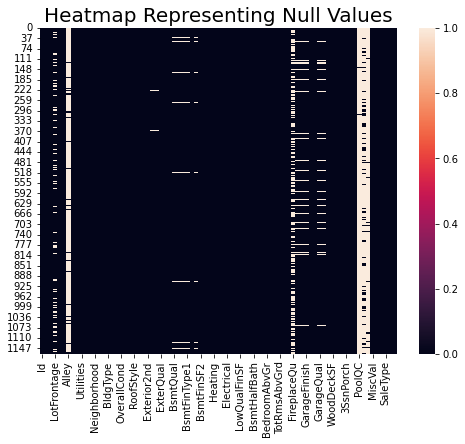

In [12]:
plt.figure(figsize=(8,6))
sns.heatmap(df.isnull())
plt.title("Heatmap Representing Null Values",fontsize=20)

# Missing Values

- Alley            1091
- PoolQC           1161
- MiscFeature      1124
- Fence             931
- FireplaceQu       551
- LotFrontage       214
- GarageType         64
- GarageYrBlt        64
- GarageFinish       64
- GarageQual         64
- GarageCond         64
- BsmtQual           30
- BsmtCond           30
- BsmtFinType1       30
- BsmtExposure       31
- BsmtFinType2       31
- MasVnrType          7

# Checking Unique and duplicated Values in columns

In [13]:
df.nunique()

Id               1168
MSSubClass         15
MSZoning            5
LotFrontage       106
LotArea           892
Street              2
Alley               2
LotShape            4
LandContour         4
Utilities           1
LotConfig           5
LandSlope           3
Neighborhood       25
Condition1          9
Condition2          8
BldgType            5
HouseStyle          8
OverallQual        10
OverallCond         9
YearBuilt         110
YearRemodAdd       61
RoofStyle           6
RoofMatl            8
Exterior1st        14
Exterior2nd        15
MasVnrType          4
MasVnrArea        283
ExterQual           4
ExterCond           5
Foundation          6
BsmtQual            4
BsmtCond            4
BsmtExposure        4
BsmtFinType1        6
BsmtFinSF1        551
BsmtFinType2        6
BsmtFinSF2        122
BsmtUnfSF         681
TotalBsmtSF       636
Heating             6
HeatingQC           5
CentralAir          2
Electrical          5
1stFlrSF          669
2ndFlrSF          351
LowQualFin

In [14]:
df['Id'].is_unique # all unique no duplicted value

True

In [15]:
df['MSSubClass'].unique()

array([120,  20,  60,  50,  70,  30, 160,  85,  45,  90,  40,  80, 190,
        75, 180], dtype=int64)

# Using Loop to check unique values from Loop:

1. Categorical Data

In [16]:
for i in df.columns:
    if df[i].dtypes=='object':
        print(i)
        print(df[i].unique())
        print("**"*20)

MSZoning
['RL' 'RM' 'FV' 'RH' 'C (all)']
****************************************
Street
['Pave' 'Grvl']
****************************************
Alley
[nan 'Grvl' 'Pave']
****************************************
LotShape
['IR1' 'Reg' 'IR2' 'IR3']
****************************************
LandContour
['Lvl' 'Bnk' 'HLS' 'Low']
****************************************
Utilities
['AllPub']
****************************************
LotConfig
['Inside' 'CulDSac' 'FR2' 'Corner' 'FR3']
****************************************
LandSlope
['Gtl' 'Mod' 'Sev']
****************************************
Neighborhood
['NPkVill' 'NAmes' 'NoRidge' 'NWAmes' 'Gilbert' 'Sawyer' 'Edwards'
 'IDOTRR' 'CollgCr' 'Mitchel' 'Crawfor' 'BrDale' 'StoneBr' 'BrkSide'
 'NridgHt' 'OldTown' 'Somerst' 'Timber' 'SWISU' 'SawyerW' 'ClearCr'
 'Veenker' 'Blmngtn' 'MeadowV' 'Blueste']
****************************************
Condition1
['Norm' 'Feedr' 'RRAn' 'PosA' 'RRAe' 'Artery' 'PosN' 'RRNe' 'RRNn']
***************************

# Observation  for categorical data shows

1. Alley haveing nan Value
2. MasVnrType having nan Value
3. BsmtQual having nan Value
4. BsmtCond having nan Value
5. BsmtExposure having nan Value
6. BsmtFinType1 having nan Value
7. BsmtFinType2 having nan Value
08. FireplaceQu having nan Value
09. GarageType having nan Value
10. GarageFinish having nan Value
11. GarageQual having nan value
12. PoolQC having nan value
13. MiscFeature nan value

# Numerical Values

In [17]:
for i in df.columns:
    if df[i].dtypes=='int64':
        print(i)
        print(df[i].unique())
        print("**"*20)

Id
[127 889 793 ... 196  31 617]
****************************************
MSSubClass
[120  20  60  50  70  30 160  85  45  90  40  80 190  75 180]
****************************************
LotArea
[  4928  15865   9920  11751  16635  14054  11341  13125   9170   8480
   8600   9548   9196   8892  16466  10592   5890   7314   7917   2016
  12435   8445   9717  10659   9230  21000  25339  11394   6380  11988
   7658   3378  18890  12358  14762  10356  10400  12615   7540   9100
  31770  13300   3180   2522   8385   8314   8123  12000   5000   7931
  14331  10440   8400   8712  11100   9742  19900  10186   8765  11923
   7200   7838   7024  11287   8834   5500   9858  32668   8760   8366
   9158   6780   9020   4270  10637  10410  13891  16196   8990   8635
   9786  10010   7950   6180   8461   7642   9600   9240   9525   4923
  11075   6820   9204   8973   8125   5330   5868  11250  22950  11308
  10500  13600  10152   4590   6960  14803   9317 115149   7259   7700
   7500  13031   3696  

## Observation Shows

- Found all contents to be intact

In [18]:
for i in df.columns:
    if df[i].dtypes=='float64':
        print(i)
        print(df[i].unique())
        print("**"*20)

LotFrontage
[ nan  95.  92. 105.  58.  88.  70.  80.  50.  44. 129.  59.  55.  64.
  24.  68.  71.  74.  61.  60. 120.  84. 141.  30.  65.  76. 100.  85.
  75. 107. 122.  82.  62.  73.  79.  77.  41.  69.  90.  96.  72.  34.
  78.  63.  40.  98. 160. 108. 128.  51.  81.  99.  66.  37. 174.  87.
  53. 152.  47.  86.  56.  89.  35.  52.  21. 104.  57.  83.  46. 101.
 112. 149.  93.  49.  43. 130.  54.  91.  67.  97. 110. 103. 115.  94.
  48.  36. 313. 109. 144. 121. 102. 116. 182.  32.  42. 168. 118.  38.
 140. 134. 114. 124.  39. 111.  45. 106. 153.]
****************************************
MasVnrArea
[0.000e+00 4.800e+02 1.260e+02 1.800e+02 6.700e+01 2.230e+02 6.600e+01
 8.200e+01 1.740e+02 3.040e+02 1.720e+02 1.660e+02 1.840e+02 3.500e+02
 4.120e+02 1.000e+00 1.890e+02 1.120e+02 5.000e+01 2.200e+02 1.600e+01
 6.300e+02 2.810e+02 2.870e+02 3.400e+02 2.160e+02       nan 1.400e+02
 1.830e+02 3.360e+02 3.960e+02 2.320e+02 3.200e+02 8.500e+01 1.620e+02
 1.540e+02 1.760e+02 1.200e+02 1.080e

## Observation Show Float Data:
1. MasVnrArea shows nan value
2. GarageYrBlt shows nan Value

# Missing Percentage

In [19]:
for i in df.columns:
    Total_Value=len(df[i])
    Missing_Value=df[i].isnull().sum()
    print(i,"Missing percentage :",round(((Missing_Value/Total_Value)*100),2))

Id Missing percentage : 0.0
MSSubClass Missing percentage : 0.0
MSZoning Missing percentage : 0.0
LotFrontage Missing percentage : 18.32
LotArea Missing percentage : 0.0
Street Missing percentage : 0.0
Alley Missing percentage : 93.41
LotShape Missing percentage : 0.0
LandContour Missing percentage : 0.0
Utilities Missing percentage : 0.0
LotConfig Missing percentage : 0.0
LandSlope Missing percentage : 0.0
Neighborhood Missing percentage : 0.0
Condition1 Missing percentage : 0.0
Condition2 Missing percentage : 0.0
BldgType Missing percentage : 0.0
HouseStyle Missing percentage : 0.0
OverallQual Missing percentage : 0.0
OverallCond Missing percentage : 0.0
YearBuilt Missing percentage : 0.0
YearRemodAdd Missing percentage : 0.0
RoofStyle Missing percentage : 0.0
RoofMatl Missing percentage : 0.0
Exterior1st Missing percentage : 0.0
Exterior2nd Missing percentage : 0.0
MasVnrType Missing percentage : 0.6
MasVnrArea Missing percentage : 0.6
ExterQual Missing percentage : 0.0
ExterCond Mi

Deleting Rows as missing percentage is more than 75 percentage:

- Alley Missing percentage : 93.40753424657534
- PoolQC Missing percentage : 99.40068493150685
- Fence Missing percentage : 79.70890410958904
- MiscFeature Missing percentage : 96.23287671232876

In [20]:
df.drop(['Alley','PoolQC','MiscFeature','Fence'],axis=1,inplace=True)

- FireplaceQu 551
- LotFrontage 214
- GarageType 64
- GarageYrBlt 64
- GarageFinish 64
- GarageQual 64
- GarageCond 64
- BsmtQual 30
- BsmtCond 30
- BsmtFinType1 30
- BsmtExposure 31
- BsmtFinType2 31
- MasVnrType 7

In [21]:
# Deleting All columns which doesn't add much value to Target Variable. 

df.drop(['Id','Utilities'],axis=1,inplace=True)

# Imputing Null Values

In [22]:
from sklearn.impute import SimpleImputer
si_cat=SimpleImputer(missing_values=np.nan,strategy='most_frequent')
si_num=SimpleImputer(missing_values=np.nan,strategy='median')

#  Replace Categorical Variable
for i in df.columns:
    if df[i].dtype=='object':
        df[i]=si_cat.fit_transform(df[i].values.reshape(-1,1))
        
# Replace Numerical and float value:

for i in df.columns:
    if df[i].dtype=='float64':
        df[i]=si_num.fit_transform(df[i].values.reshape(-1,1))

In [23]:
df.isnull().sum()

MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
LotShape         0
LandContour      0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual      0
TotRmsAbvGrd     0
Functional  

In [24]:
df.duplicated()

0       False
1       False
2       False
3       False
4       False
5       False
6       False
7       False
8       False
9       False
10      False
11      False
12      False
13      False
14      False
15      False
16      False
17      False
18      False
19      False
20      False
21      False
22      False
23      False
24      False
25      False
26      False
27      False
28      False
29      False
30      False
31      False
32      False
33      False
34      False
35      False
36      False
37      False
38      False
39      False
40      False
41      False
42      False
43      False
44      False
45      False
46      False
47      False
48      False
49      False
50      False
51      False
52      False
53      False
54      False
55      False
56      False
57      False
58      False
59      False
60      False
61      False
62      False
63      False
64      False
65      False
66      False
67      False
68      False
69      False
70      False
71    

Text(0.5, 1.0, 'Heatmap Representing Null Values')

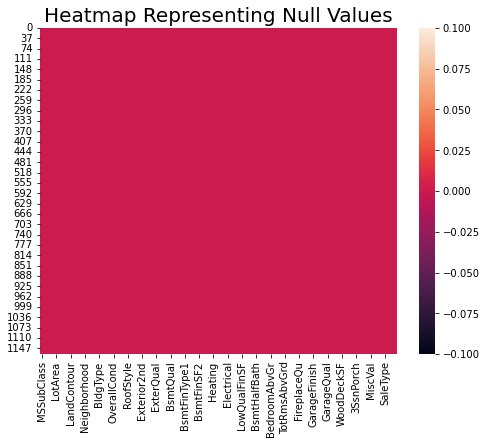

In [25]:
# Visualization with heatmap

plt.figure(figsize=(8,6))
sns.heatmap(df.isnull())
plt.title("Heatmap Representing Null Values",fontsize=20)

# EDA(Exploratory Data Analysis)

In [26]:
df.Category_Variable=[]
df.Numeric_Variable=[]

for i in df.columns:
    if df[i].dtypes=='object':
        df.Category_Variable.append(i)
    else:
        df.Numeric_Variable.append(i)
        
print('Category_Variable Columns\n',df.Category_Variable,'\n\nNumeric and Float variables columns\n',df.Numeric_Variable)

Category_Variable Columns
 ['MSZoning', 'Street', 'LotShape', 'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition'] 

Numeric and Float variables columns
 ['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF

# Checking Value_Counts

In [27]:
for i in df.Category_Variable:
    print(i,"\n**"*1)
    print(df[i].value_counts())
    print("**"*20,'\n')

MSZoning 
**
RL         928
RM         163
FV          52
RH          16
C (all)      9
Name: MSZoning, dtype: int64
**************************************** 

Street 
**
Pave    1164
Grvl       4
Name: Street, dtype: int64
**************************************** 

LotShape 
**
Reg    740
IR1    390
IR2     32
IR3      6
Name: LotShape, dtype: int64
**************************************** 

LandContour 
**
Lvl    1046
Bnk      50
HLS      42
Low      30
Name: LandContour, dtype: int64
**************************************** 

LotConfig 
**
Inside     842
Corner     222
CulDSac     69
FR2         33
FR3          2
Name: LotConfig, dtype: int64
**************************************** 

LandSlope 
**
Gtl    1105
Mod      51
Sev      12
Name: LandSlope, dtype: int64
**************************************** 

Neighborhood 
**
NAmes      182
CollgCr    118
OldTown     86
Edwards     83
Somerst     68
Gilbert     64
NridgHt     61
Sawyer      60
NWAmes      59
SawyerW     51
BrkSide     5

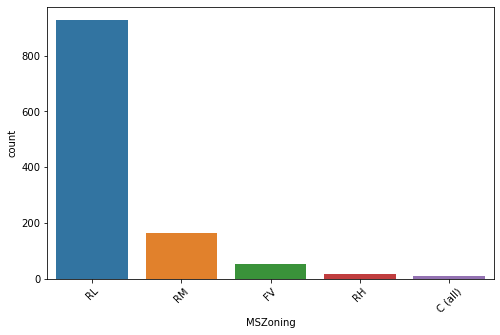

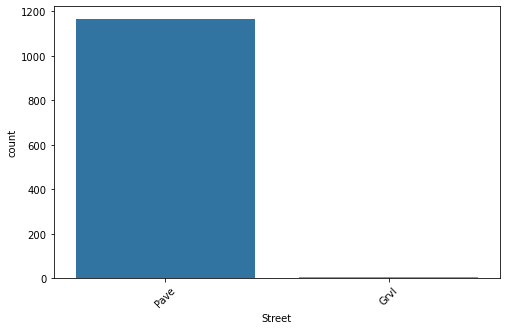

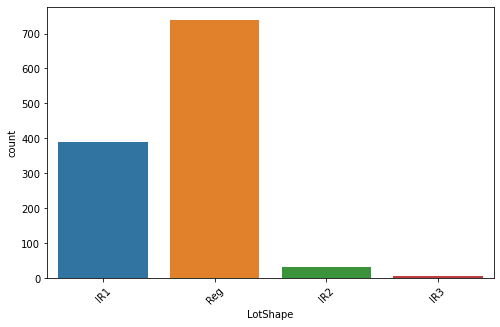

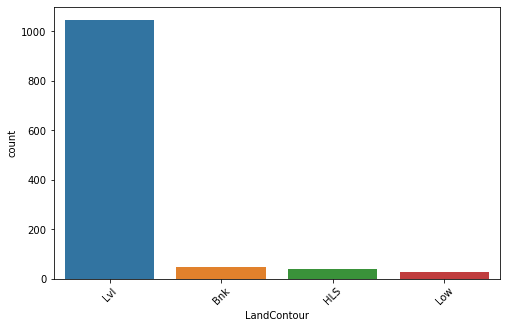

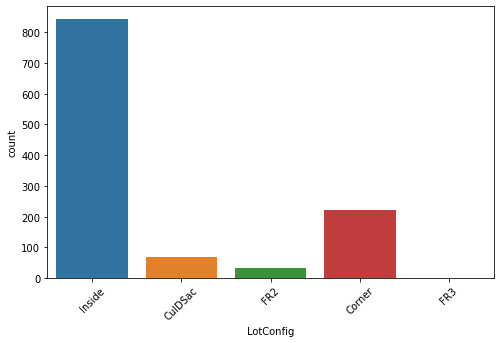

...

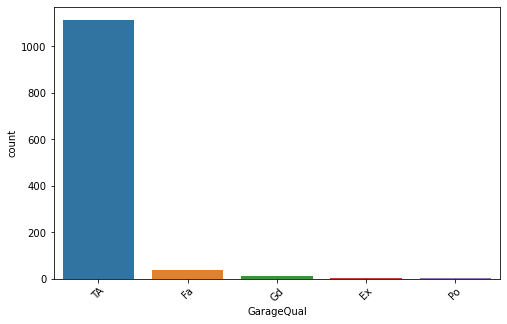

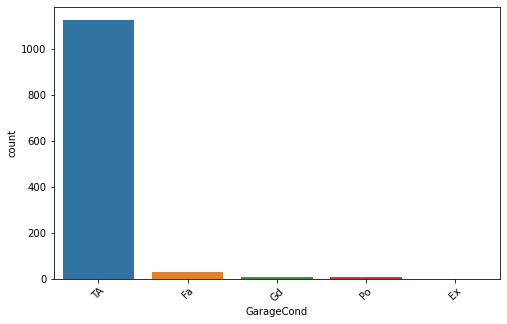

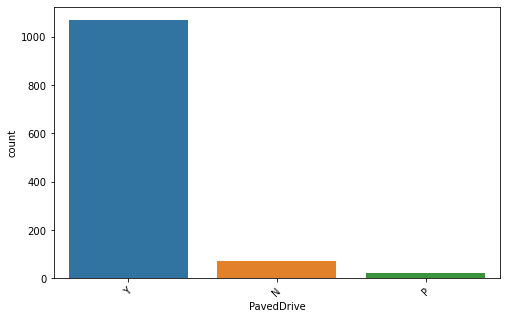

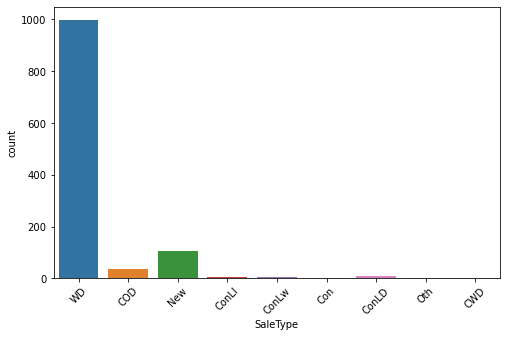

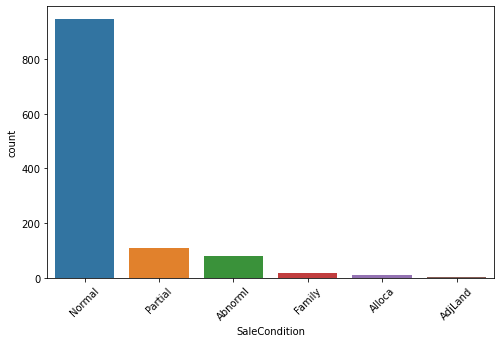

In [28]:
for i in df.Category_Variable:
    plt.figure(figsize=(8,5))
    sns.countplot(x=df[i])
    plt.xticks(rotation=45,fontsize = 10)
    plt.yticks(rotation=0,fontsize = 10)

# Observation Shows:

- MSZoning: Identifies the general zoning classification of the sale.
RL,RM Zones Are More RL  =928, RM =163,FV= 52,RH=16,C(all)=9

- Streets Type of road access to property
Street have Maximum Pave

- LotShape: General shape of property 
Shows Reg(Regular) LotShape lies the Maximum (Slightly irregular)IR1  is more and (Moderately Irregular) IR2 lies the less then IR1 and IR3(Irragular) lie the least.

- LandContour: Flatness of the property
 Shows (Lvl) Near Flat/Level are maximum, followed by Bnk (Banked),(Hillside) and (Low	Depression) land lies the least.
 
- LotConfig: Lot configuration
Shows (Inside lot) is maximum, followed by (Corner lot,Cul-de-sac,Frontage on 2 sides of property) and FR3 lies the least

- LandSlope: Slope of property
Shows(Gentle slope) is maximum, followed by (Moderate Slope) and (Severe Slope) lies the least.

- Neighborhood: Physical locations within Ames city limits
Shows (North Ames) is maximum, followed by (collgCr) and others

- Condition1: Proximity to various conditions
Shows(Norm) Normal is maximum,  followed by Adjacent to feeder street(Feedr) and others Within 200' of East-West Railroad (RRNn) lies the lowest.

- Condition2: Proximity to various conditions (if more than one is present)
Shows(Norm) Normal is maximum.

- BldgType: Type of dwelling
Shows (1Fam) Family detached ia maximum, followed by (TwnhsE) and others.

- HouseStyle: Style of dwelling
Shows (1Story is max followed by 2Story, 1.5Fin and others)

- RoofStyle: Type of roof
Shows Gable is maximum, followed by Hip(Hip) and Shed is least

- RoofMatl: Roof material
Shows Standard (Composite) Shingle is maximum.

- Exterior1st: Exterior covering on house
Shows ( VinylSd	Vinyl Siding) is maximum. (Wood Siding, Metal Siding, Plywood,Hard Board are modarately prefered)

- Exterior2nd: Exterior covering on house (if more than one material)
Shows ( VinylSd	Vinyl Siding) is maximum. (Wood Siding, Metal Siding, Plywood,Hard Board are modarately prefered)

- MasVnrType: Masonry veneer type
Shows(None) is maximum, followed by Brick Face, stone and (BrkCmn) Brick Common lies the least.

- ExterQual: Evaluates the quality of the material on the exterior 
Shows Average and typical Lies the most, followed by good and excellent and FA lies the least

- ExterCond: Evaluates the present condition of the material on the exterior
Shows TA Lies the Max,followd by Gd, and Fa lies the least.

- Foundation: Type of foundation
Shows (Cinder Block,Poured Contrete) lies the maximum followed by Brick & Tile,Stone and Slab, Use of Wood is least

- BsmtQual: Evaluates the height of the basement
Shows that Typical (80-89 inches)TA =1071, Good 90-99 inches= 56, Fair (70-79 inches)= 39,Poor (<70 inches)=2

- BsmtCond: Evaluates the general condition of the basement.
Shows that  TA	Typical lies Maximum, followed by Average and Good.

- BsmtExposure: Refers to walkout or garden level walls
Shows that No Exposure is Maximum followed by Average and Good.

- BsmtFinType1: Rating of basement finished area.
Shows that unf(Unfinished) and GLQ (Good Living Quarters) is maximum

- BsmtFinType2: Rating of basement finished area (if multiple types)
Shows that (GasA) 1143 are maximum followed by GasW       14,Grav        5,Wall        4,Floor       1,OthW        1

- Heating: Heating quality and condition
Shows that Excellent is Maximum followed by Average/Typical and others

- CentralAir: Central air conditioning
Shows maximum Yes in Central air conditioning, No lies the least.

- Electrical: Electrical system
Shows (Standard Circuit Breakers & Romex) SBrkr=1070 that is maximum, FuseA =74, FuseF= 21,FuseP=2 , Mix= 1

- KitchenQual: Kitchen quality
TA(Typical/Average)   578, Gd(Good)   478, Ex(Excellent)    82, Fa(Fair)    30

- Functional: Home functionality (Assume typical unless deductions are warranted)
Typ	(Typical Functionality) is Maximum followed by   Min1(Minor Deductions1) , Min2	(Minor Deductions2) and others
    
- FireplaceQu: Fireplace quality
Shows that Good= 852, Typical/Average= 252, Fair= 25, Excellent=21, Poor=18.

- GarageType: Garage location
Shows that Attached to home is Maximum and Detached from home is maximum other are less on compare.

- GarageFinish: Interior finish of the garage
Shows that Unfinished is followed by Finished and Rough Finished.

- GarageQual: Garage quality
Shows that Typical/Average are maximum followed by others.

- GarageCond: Garage condition
Shows that Typical/Average are maximum followed by others.

- PavedDrive: Paved driveway
Shows that Paved are maximum followed by Dirt/Gravel and Partial Pavement.

- SaleType: Type of sale
Columns Shows that Warranty Deed Sale is maximum, Home just constructed and sold are more in count then others.

- SaleCondition: Condition of sale
Columns Shows that normal Sale are maximum. followed by partial Abnormal and Family sales.
		

# Univaraite Numerical Variable 

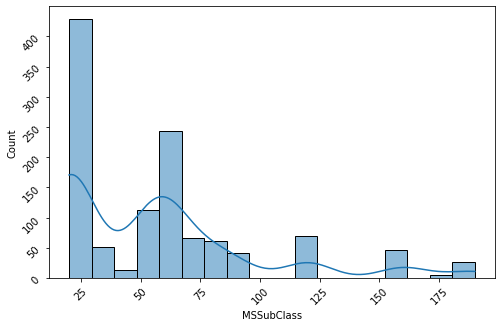

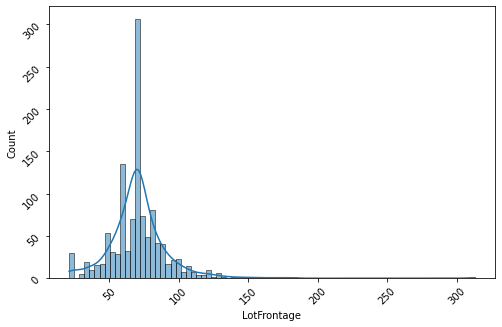

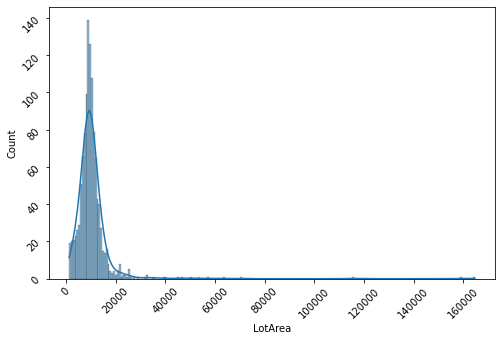

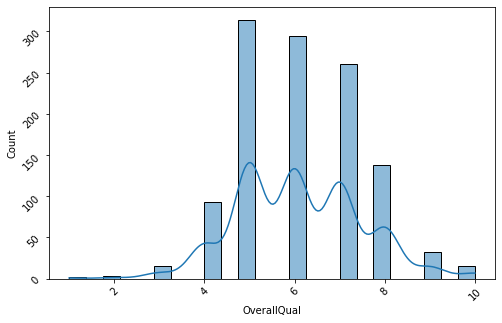

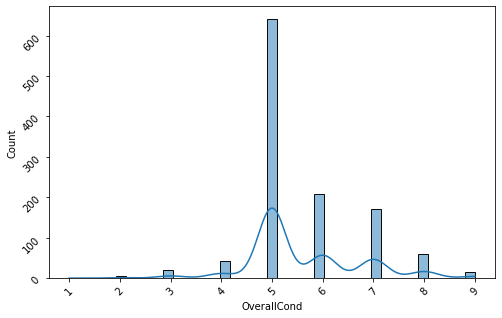

...

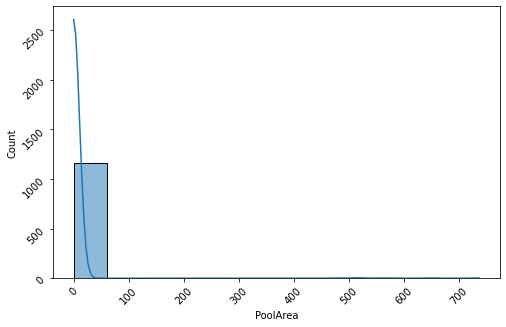

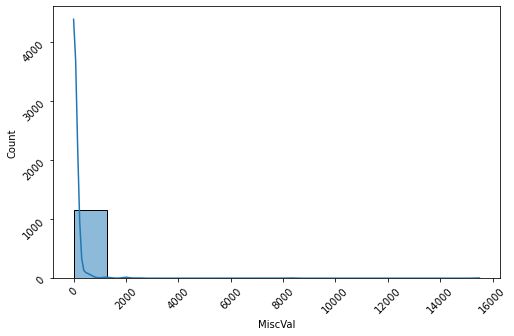

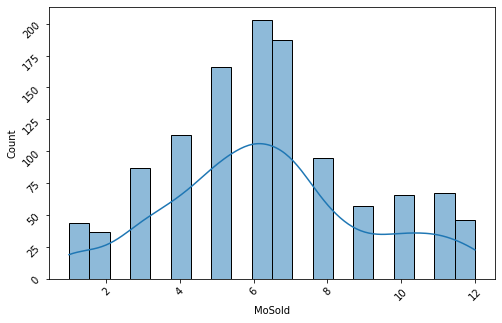

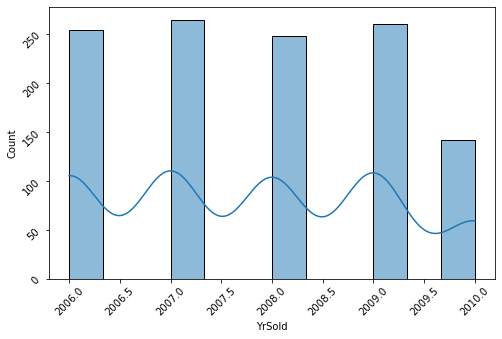

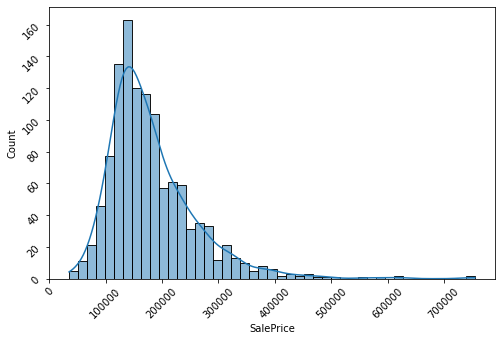

In [29]:
for i in df.Numeric_Variable:
    plt.figure(figsize=(8,5))
    sns.histplot(x=df[i],kde=True)
    plt.xticks(rotation=45,fontsize = 10)
    plt.yticks(rotation=45,fontsize = 10)

# Observation

- MSSubClass- Maximum dwelling involved in sales  at 20 to 30, followed by 50 to 75
- LotFrontage Shows that Maximum Frequency lies between 50 to to 100
- LotArea maximum lies between 0 to 2000
- Rates the overall material and finish of the house (OverallQual) Shows that maximum at 5.
- Rates the overall condition of the house (OverallCond) Shows that maximum lies at 5 followed by 5 to 9.
- Original construction data maximum lies at 2000, Maximum demands lies at 2000.
- Remodel date (same as construction date if no remodeling or additions) shows maximum frequency lie at 2000 to 2010
- Masonry veneer area in square feet lies maximum at 0 to 200
- basement finished area (bsmtFinSF1) maximum lies 0 to 1000
- basement finished area (BsmtFinSF2) maximum lies between 0 to 200
- Unfinished square feet of basement area (BsmtUnfSF) maximum lies between 0 to 500 and so on.
- TotalBsmtSF lies maximum at 1000 maximum frequency lies between o to 2000
- First Floor square feet (1stFlrSF) lies maximum at 1000
- Second floor square feet (2ndFlrSF) lies maximum at 0 to 100 followed by 600 to 950
- Low quality finished square feet (all floors) shows maximum counts at 0 to 50
- Above grade (ground) living area square feet shows maximum lies at 1000 to 2000
- Basement full bathrooms (BsmtFullBath) maximum lies at 0 to 0.2
- Basement half bathrooms (BsmtHalfBath) maximum lies between 0.00 to 0.25 followed by 1.00 to 1.25
- Full bathrooms above grade (FullBath) maximum lies between 0.5 to 1.5 followed by 1.5 to 2.5 and 2.5
- Half baths above grade (HalfBath) maximum lies between 0.0 to 0.50, 0.75 to 1.25 and lies 2.00
- Bedrooms above grade (does  NOT include basement bedrooms) BedroomAbvGr  maximum lies at 3 followed by 2 and 4.
- Kitchens above grade maximum at 1 and 2.
- Total rooms above grade (does not include bathrooms) maximum lies at 6 and 7. distribution shows 4 to 12
- Number of fireplaces maximum lies at 0 to 0.5 followed by 0.5 to 1.5 and 1.5 to 2.5
- Year garage was built (GarageYrBlt) Maximum lies at 2000.
- Year garage was built (GarageCars) maximum lies 2.0 is max, followed 1.0 and 3.0
- GarageArea maximum lies between 400 to 600.
- WoodDeckSF lies maximum at 0 to 2000
- OpenPorchSF maximum lies o to 100
- EnclosedPorch maximum lies at 0 to 100
- 3SsnPorch maximum lies at 0 to 50
- ScreenPorch maximum lies between 0 to 50
- Pool Area Maximum lies between 0 to 50
- MiscVal Maximum lies between 0 to 1000
- MoSold Maximum lies between 4 to 8
- YrSold Maximum lies 2007 and 2009
- SalePrice Maximum lies 1000 to 2000.

# Bi-Variate Analysis

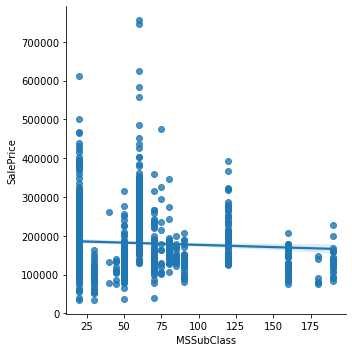

In [30]:
sns.lmplot(x='MSSubClass',y='SalePrice',data=df)

MSSubClass shows little negative relation with SalePrice

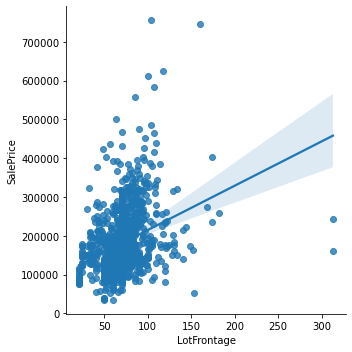

In [31]:
sns.lmplot(x='LotFrontage',y='SalePrice',data=df)

LotFrontage is very positiveto SalePrice

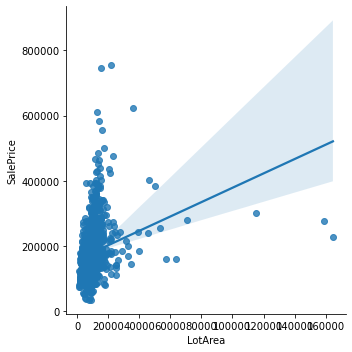

In [32]:
sns.lmplot(x='LotArea',y='SalePrice',data=df)

LotArea shows very positive relation with Target Variable

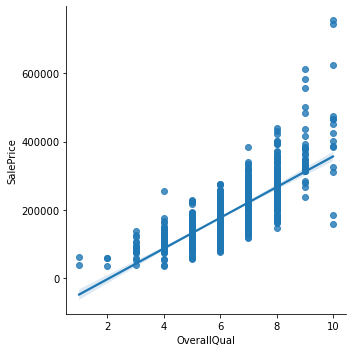

In [33]:
sns.lmplot(x='OverallQual',y='SalePrice',data=df)

OverallQual is very positive SalePrice

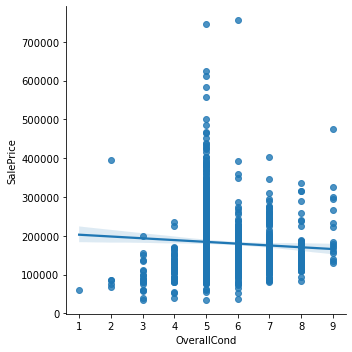

In [34]:
sns.lmplot(x='OverallCond',y='SalePrice',data=df)

OverallCond is very negative towards SalePrice

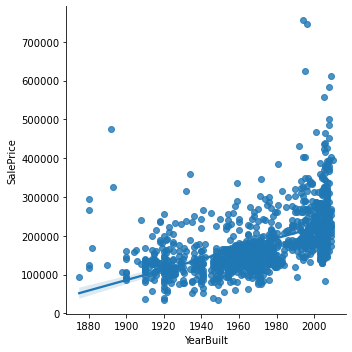

In [35]:
sns.lmplot(x='YearBuilt',y='SalePrice',data=df)

YearBuilt Shows very positive relation with Target Variable

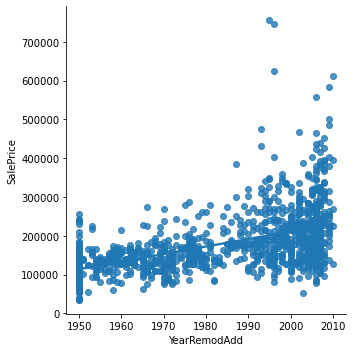

In [36]:
sns.lmplot(x='YearRemodAdd',y='SalePrice',data=df)

YearRemodAdd is positive towards SalesPrice

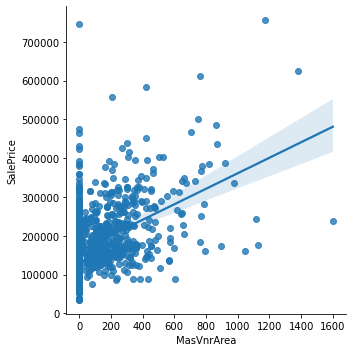

In [37]:
sns.lmplot(x='MasVnrArea',y='SalePrice',data=df)

MasVnrArea very positive towards SalesPrice

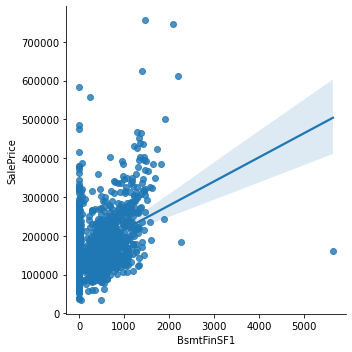

In [38]:
sns.lmplot(x='BsmtFinSF1',y='SalePrice',data=df)

BsmtFinS1 is very positive towards salesPrice

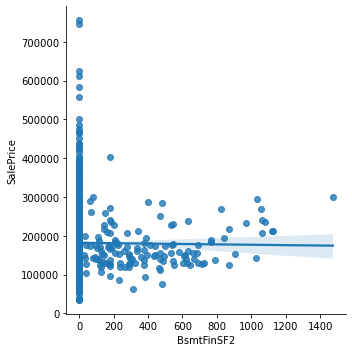

In [39]:
sns.lmplot(x='BsmtFinSF2',y='SalePrice',data=df)

BsmtFinSF2 somewhere close to SalePrice

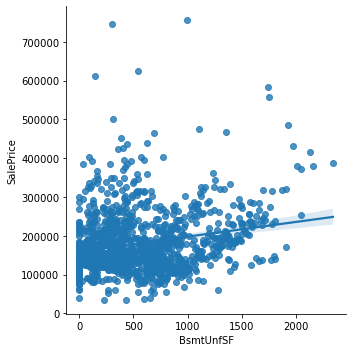

In [40]:
sns.lmplot(x='BsmtUnfSF',y='SalePrice',data=df)

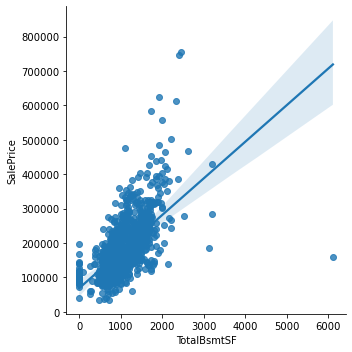

In [41]:
sns.lmplot(x='TotalBsmtSF',y='SalePrice',data=df)

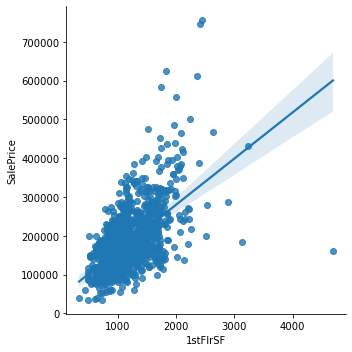

In [42]:
sns.lmplot(x='1stFlrSF',y='SalePrice',data=df)

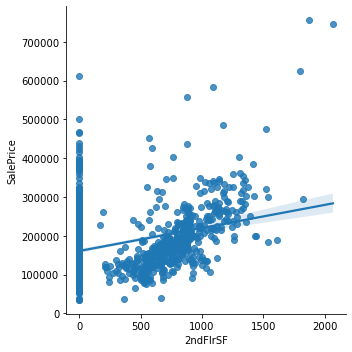

In [43]:
sns.lmplot(x='2ndFlrSF',y='SalePrice',data=df)

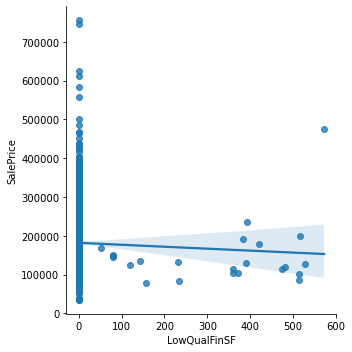

In [44]:
sns.lmplot(x='LowQualFinSF',y='SalePrice',data=df)

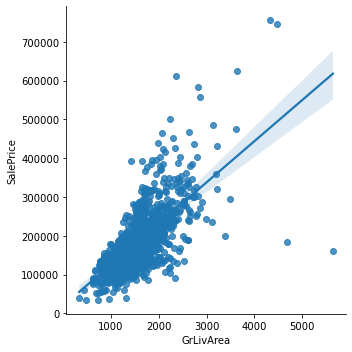

In [45]:
sns.lmplot(x='GrLivArea',y='SalePrice',data=df)

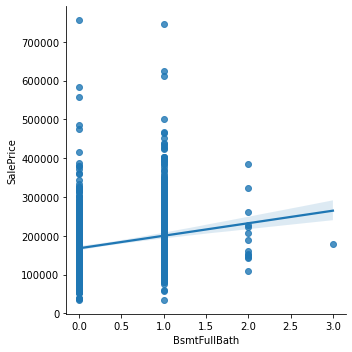

In [46]:
sns.lmplot(x='BsmtFullBath',y='SalePrice',data=df)

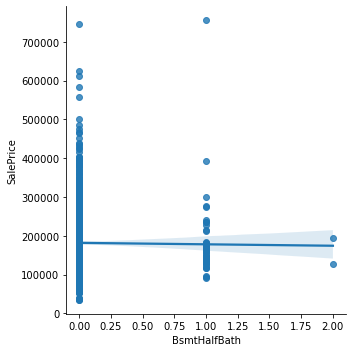

In [47]:
sns.lmplot(x='BsmtHalfBath',y='SalePrice',data=df)

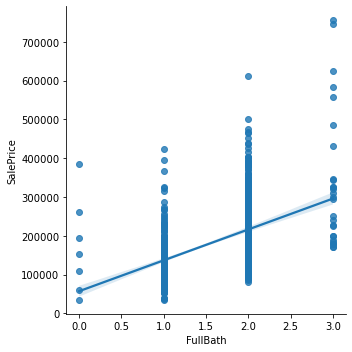

In [48]:
sns.lmplot(x='FullBath',y='SalePrice',data=df)

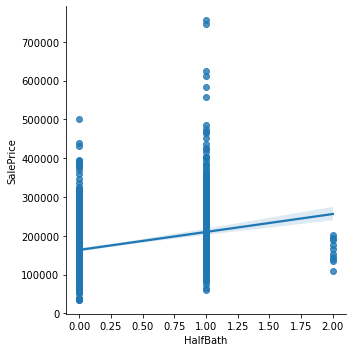

In [49]:
sns.lmplot(x='HalfBath',y='SalePrice',data=df)

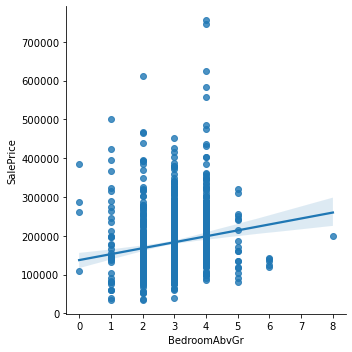

In [50]:
sns.lmplot(x='BedroomAbvGr',y='SalePrice',data=df)

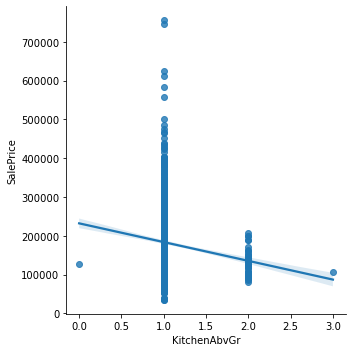

In [51]:
sns.lmplot(x='KitchenAbvGr',y='SalePrice',data=df)

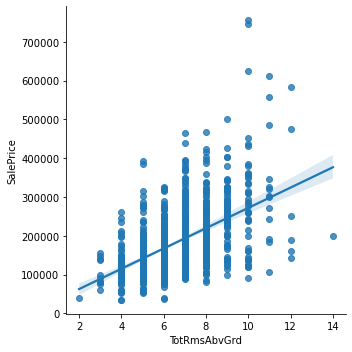

In [52]:
sns.lmplot(x='TotRmsAbvGrd',y='SalePrice',data=df)

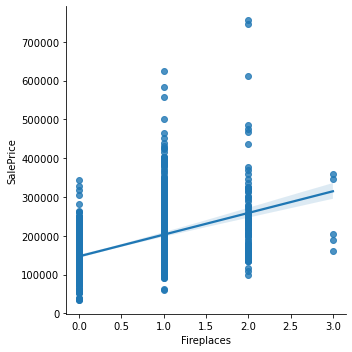

In [53]:
sns.lmplot(x='Fireplaces',y='SalePrice',data=df)

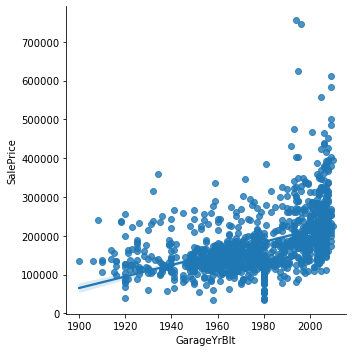

In [54]:
sns.lmplot(x='GarageYrBlt',y='SalePrice',data=df)

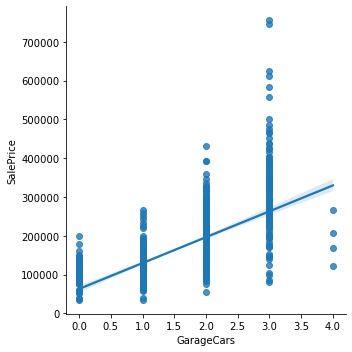

In [55]:
sns.lmplot(x='GarageCars',y='SalePrice',data=df)

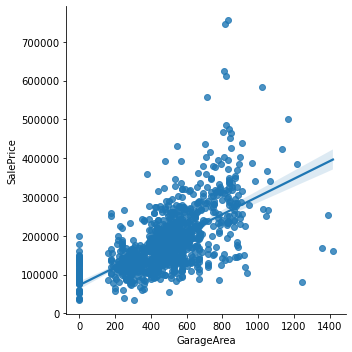

In [56]:
sns.lmplot(x='GarageArea',y='SalePrice',data=df)

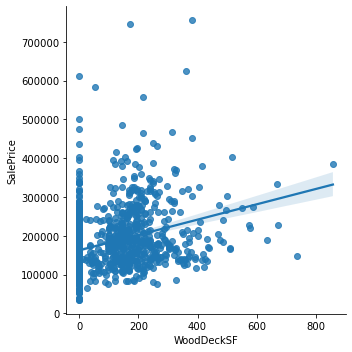

In [57]:
sns.lmplot(x='WoodDeckSF',y='SalePrice',data=df)

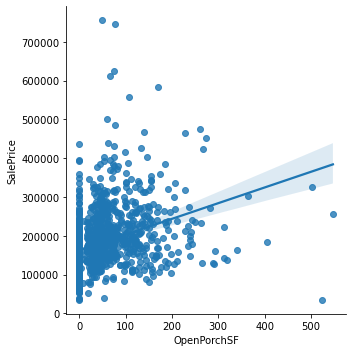

In [58]:
sns.lmplot(x='OpenPorchSF',y='SalePrice',data=df)

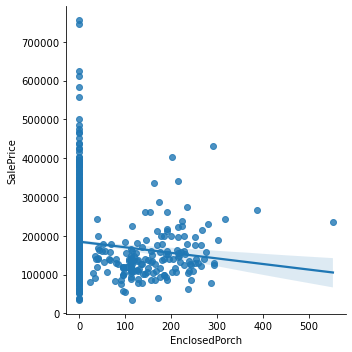

In [59]:
sns.lmplot(x='EnclosedPorch',y='SalePrice',data=df)

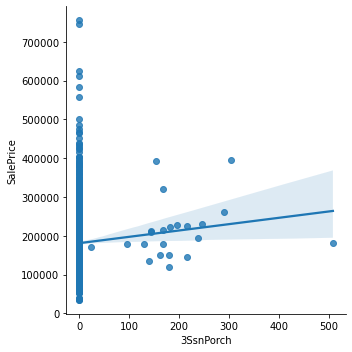

In [60]:
sns.lmplot(x='3SsnPorch',y='SalePrice',data=df)

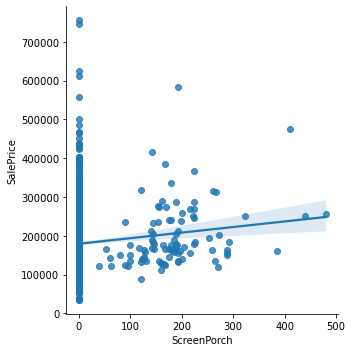

In [61]:
sns.lmplot(x='ScreenPorch',y='SalePrice',data=df)

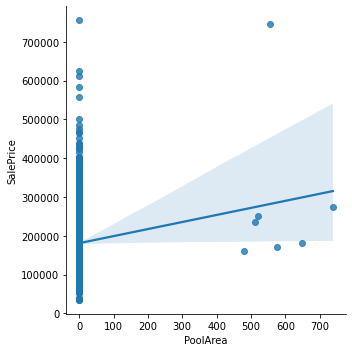

In [62]:
sns.lmplot(x='PoolArea',y='SalePrice',data=df)

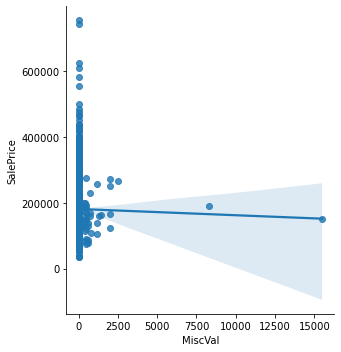

In [63]:
sns.lmplot(x='MiscVal',y='SalePrice',data=df)

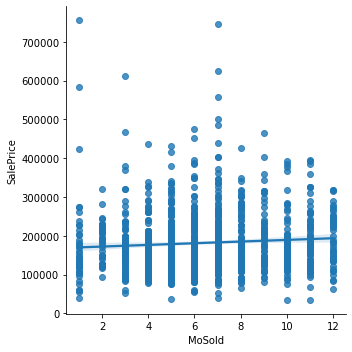

In [64]:
sns.lmplot(x='MoSold',y='SalePrice',data=df)

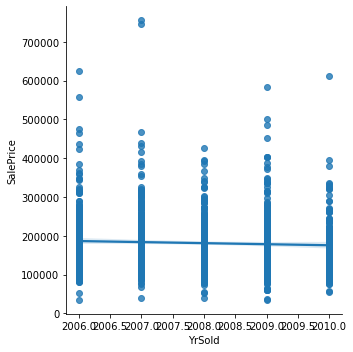

In [65]:
sns.lmplot(x='YrSold',y='SalePrice',data=df)

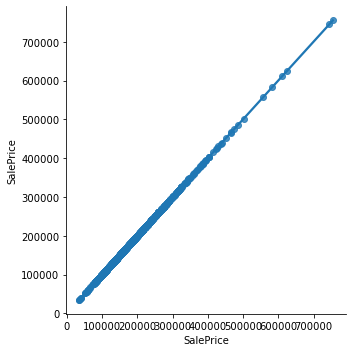

In [66]:
sns.lmplot(x='SalePrice',y='SalePrice',data=df)

# Bi-Variate(Categorical)

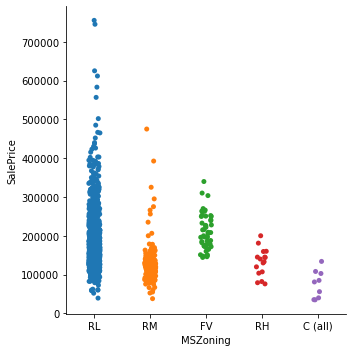

In [67]:
sns.catplot(x='MSZoning',y='SalePrice',kind='strip',data=df)

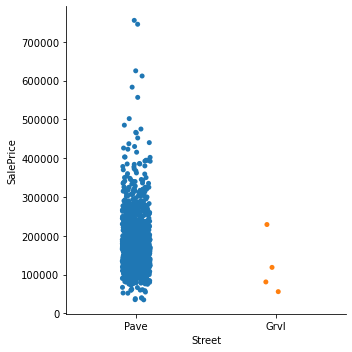

In [68]:
sns.catplot(x='Street',y='SalePrice',kind='strip',data=df)

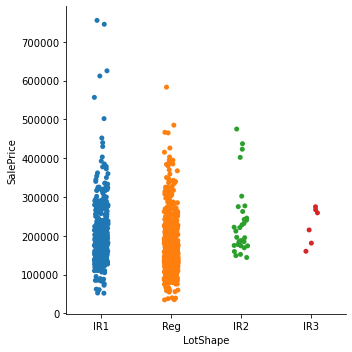

In [69]:
sns.catplot(x='LotShape',y='SalePrice',kind='strip',data=df)

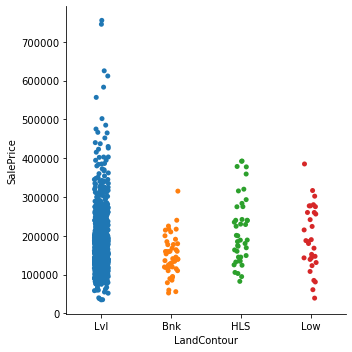

In [70]:
sns.catplot(x='LandContour',y='SalePrice',kind='strip',data=df)

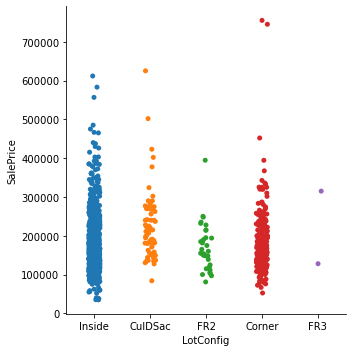

In [71]:
sns.catplot(x='LotConfig',y='SalePrice',kind='strip',data=df)

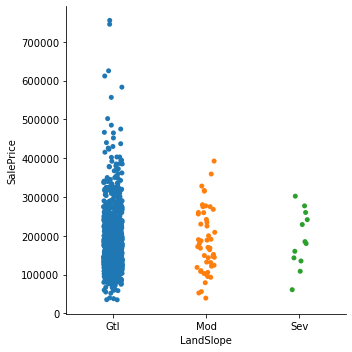

In [72]:
sns.catplot(x='LandSlope',y='SalePrice',kind='strip',data=df)

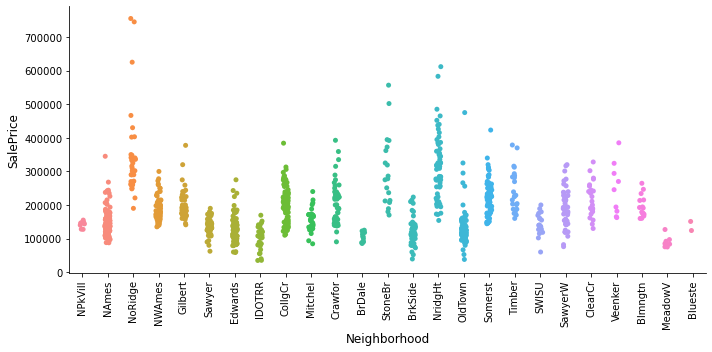

In [73]:
sns.catplot(x='Neighborhood',y='SalePrice',kind='strip',data=df,aspect=2,height=5)
plt.xticks(rotation=90,fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('Neighborhood',fontsize= 12) 
plt.ylabel('SalePrice',fontsize= 12)
plt.tight_layout()

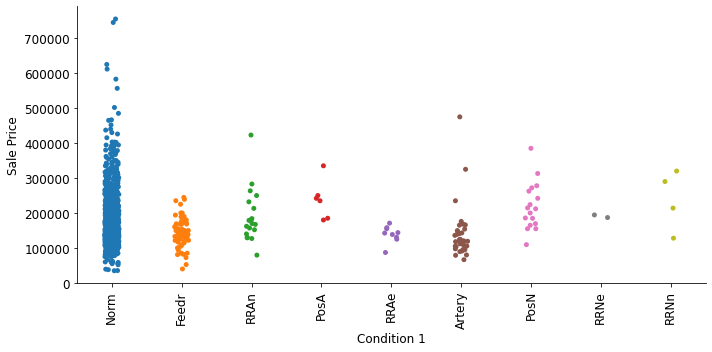

In [74]:
sns.catplot(x='Condition1',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.ylabel('Sale Price',fontsize=12)
plt.xlabel('Condition 1',fontsize=12)
plt.tight_layout()

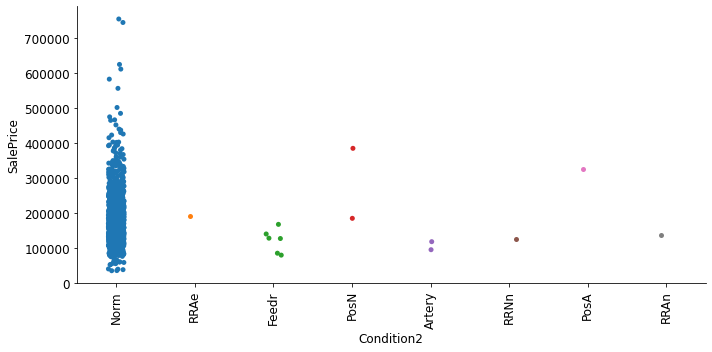

In [75]:
sns.catplot(x='Condition2',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Condition2',fontsize=12)
plt.ylabel('SalePrice',fontsize=12)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

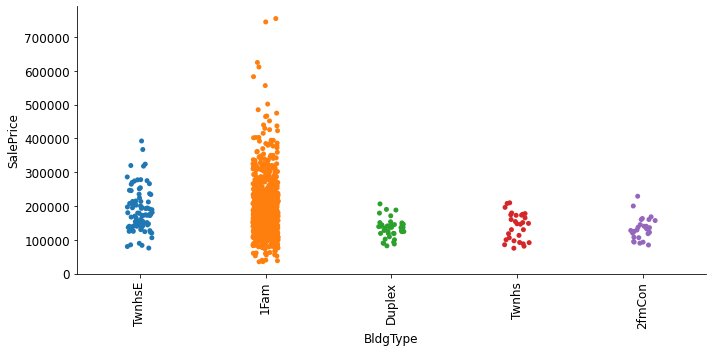

In [76]:
sns.catplot(x='BldgType',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('BldgType',fontsize=12)
plt.ylabel('SalePrice',fontsize=12)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

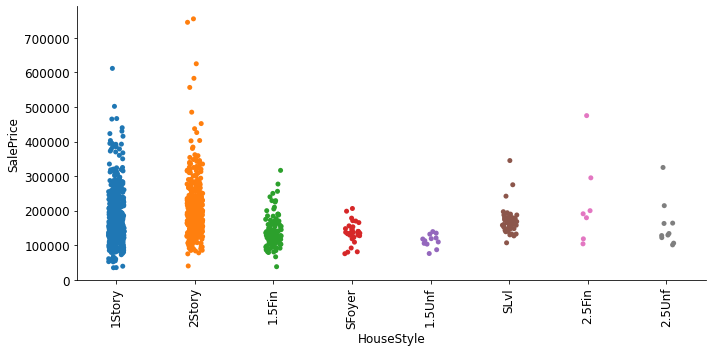

In [77]:
sns.catplot(x='HouseStyle',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('BldgType',fontsize=12)
plt.xlabel('HouseStyle',fontsize=12)
plt.ylabel('SalePrice',fontsize=12)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

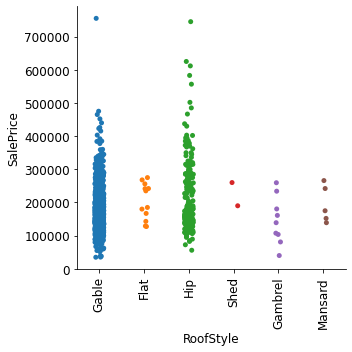

In [78]:
sns.catplot(x='RoofStyle',y='SalePrice',kind='strip',data=df)
plt.xlabel('RoofStyle',fontsize=12)
plt.ylabel('SalePrice',fontsize=12)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

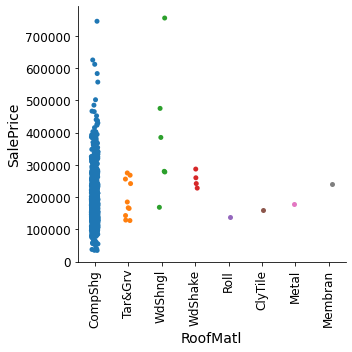

In [79]:
sns.catplot(x='RoofMatl',y='SalePrice',kind='strip',data=df)
plt.xlabel('RoofMatl',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

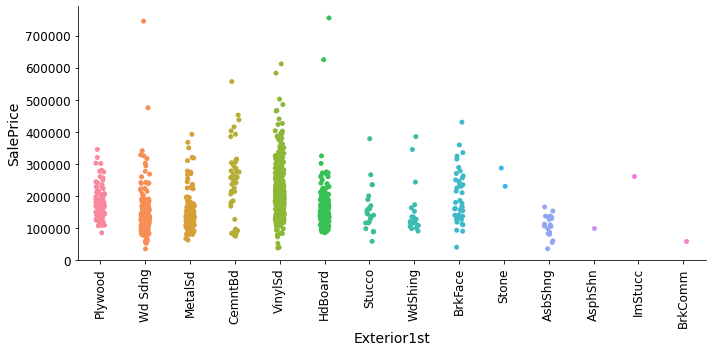

In [80]:
sns.catplot(x='Exterior1st',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Exterior1st',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

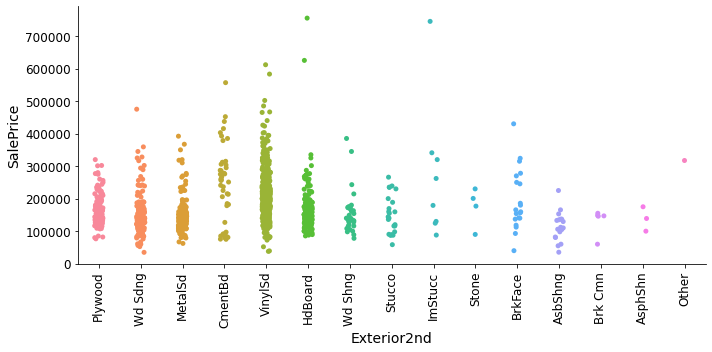

In [81]:
sns.catplot(x='Exterior2nd',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Exterior2nd',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

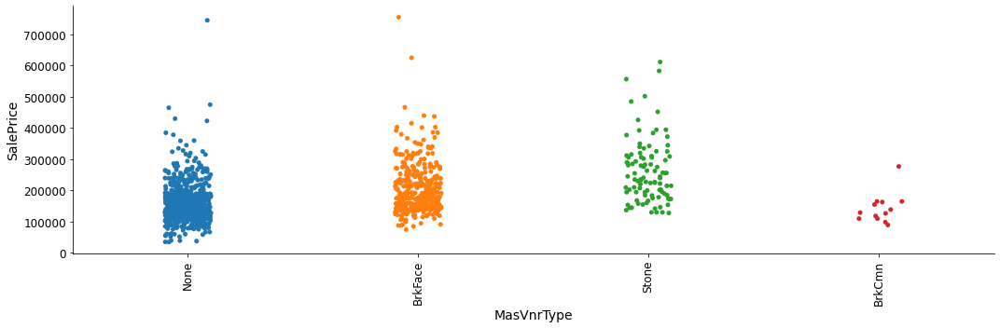

In [82]:
sns.catplot(x='MasVnrType',y='SalePrice',kind='strip',data=df,aspect=3)
plt.xlabel('MasVnrType',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

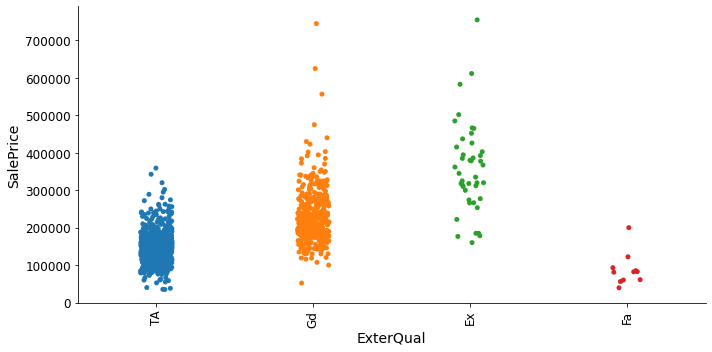

In [83]:
sns.catplot(x='ExterQual',y='SalePrice',kind='strip',data=df,aspect=2,height=5)
plt.xlabel('ExterQual',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

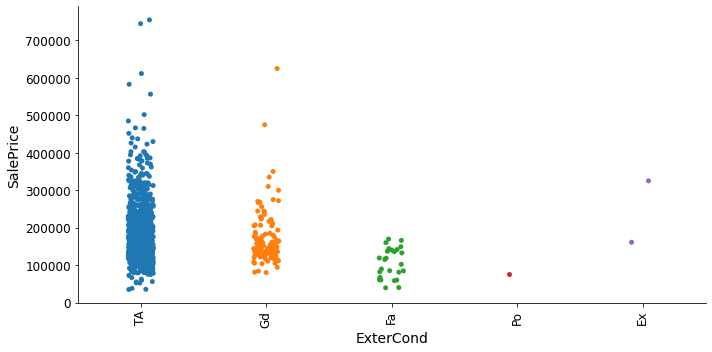

In [84]:
sns.catplot(x='ExterCond',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('ExterCond',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

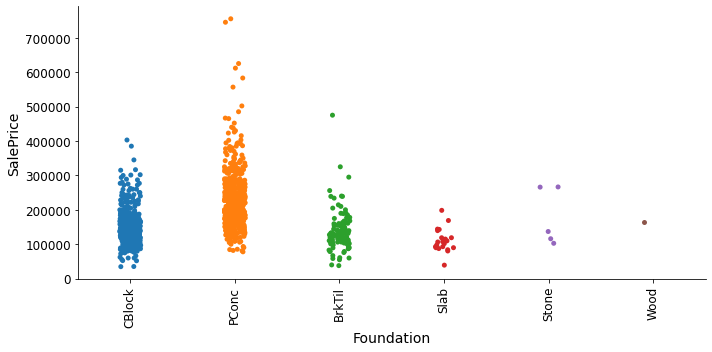

In [85]:
sns.catplot(x='Foundation',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Foundation',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

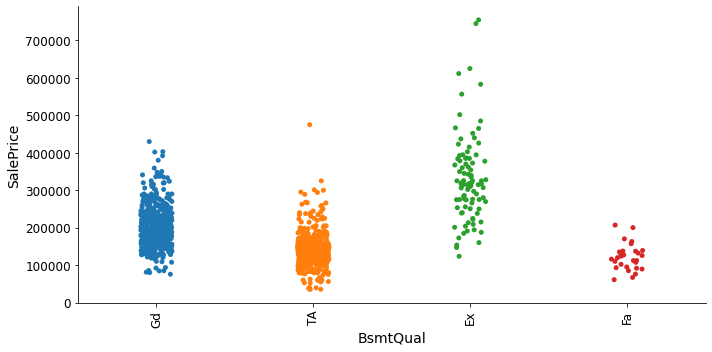

In [86]:
sns.catplot(x='BsmtQual',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('BsmtQual',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

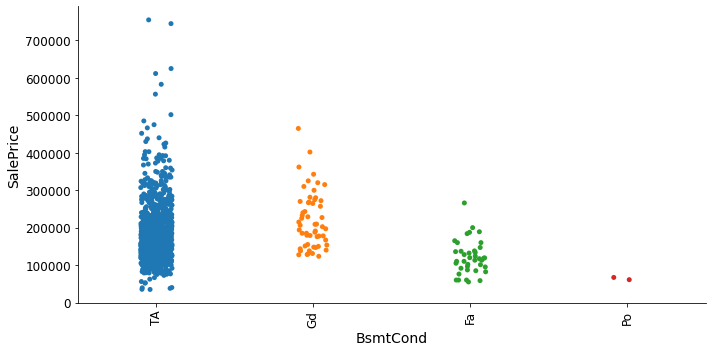

In [87]:
sns.catplot(x='BsmtCond',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('BsmtCond',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

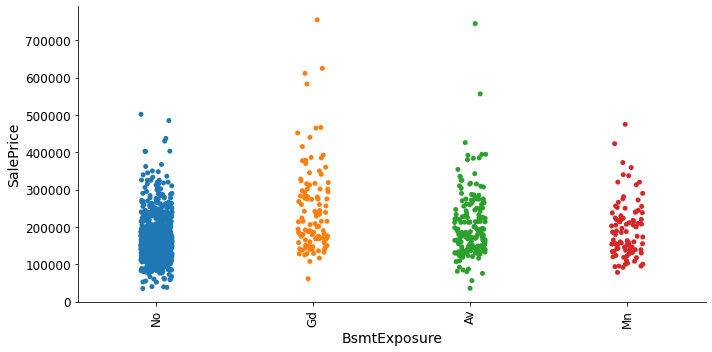

In [88]:
sns.catplot(x='BsmtExposure',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('BsmtExposure',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

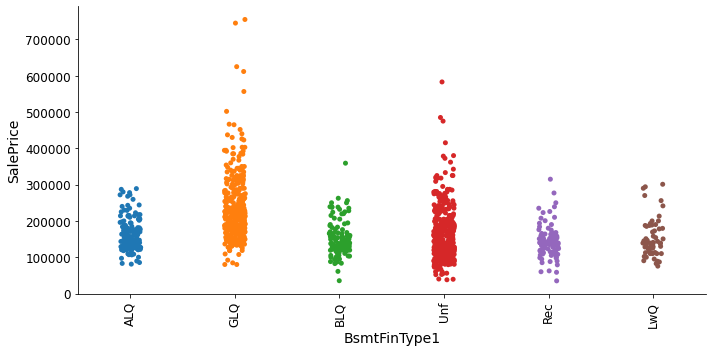

In [89]:
sns.catplot(x='BsmtFinType1',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('BsmtFinType1',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

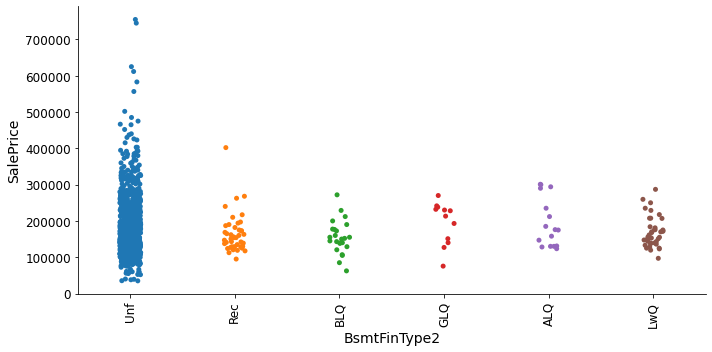

In [90]:
sns.catplot(x='BsmtFinType2',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('BsmtFinType2',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

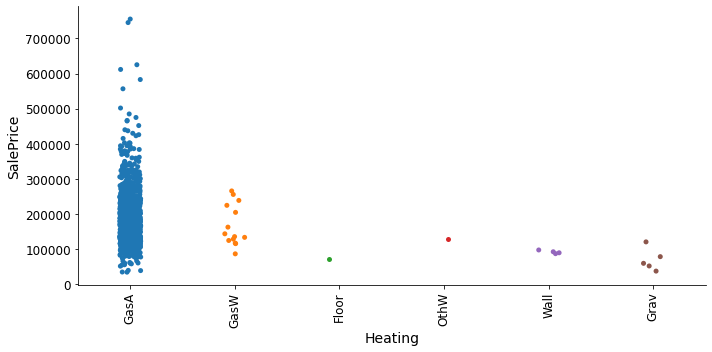

In [91]:
sns.catplot(x='Heating',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Heating',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

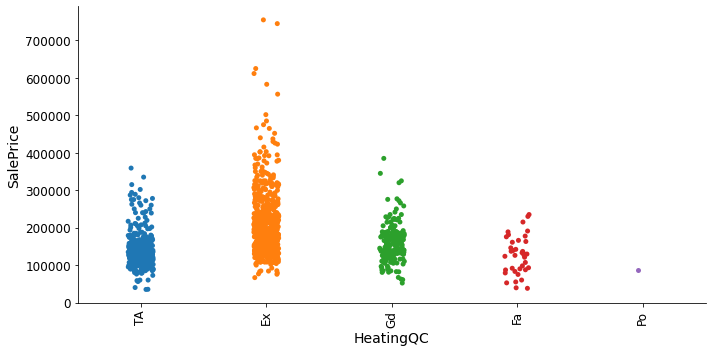

In [92]:
sns.catplot(x='HeatingQC',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('HeatingQC',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

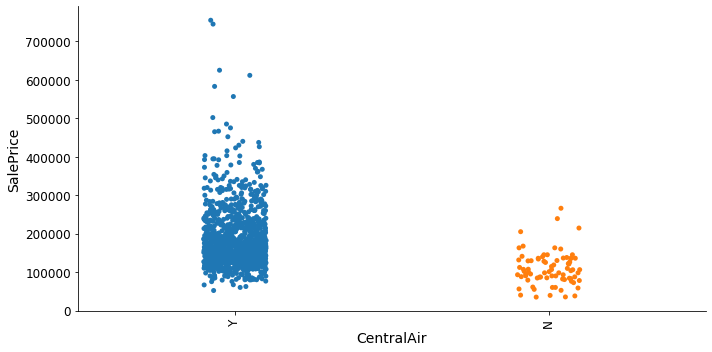

In [93]:
sns.catplot(x='CentralAir',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('CentralAir',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

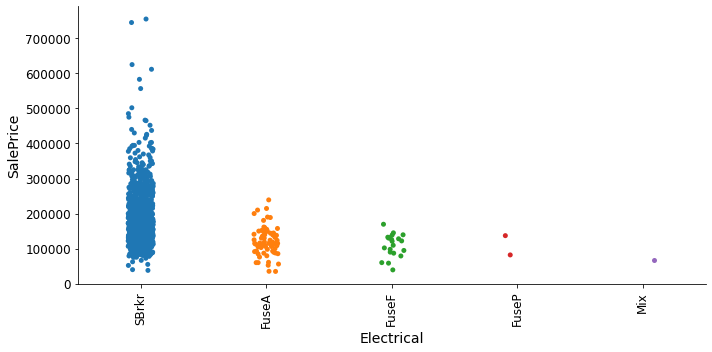

In [94]:
sns.catplot(x='Electrical',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Electrical',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

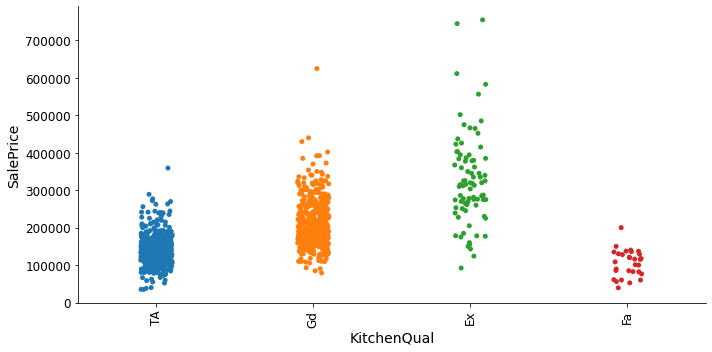

In [95]:
sns.catplot(x='KitchenQual',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('KitchenQual',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

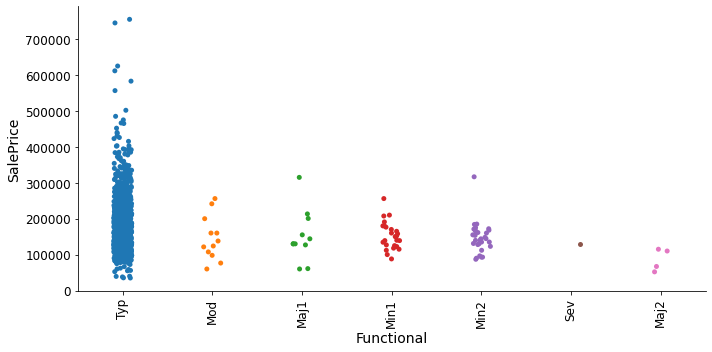

In [96]:
sns.catplot(x='Functional',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Functional',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

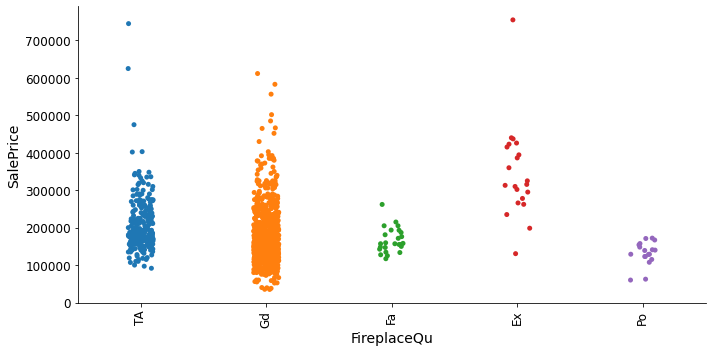

In [97]:
sns.catplot(x='FireplaceQu',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('FireplaceQu',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

### About Garage

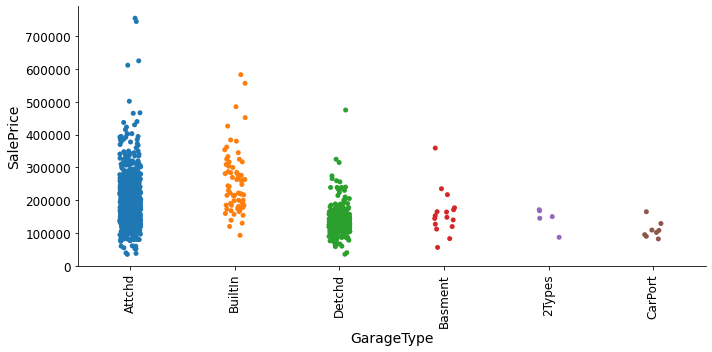

In [98]:
sns.catplot(x='GarageType',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('GarageType',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

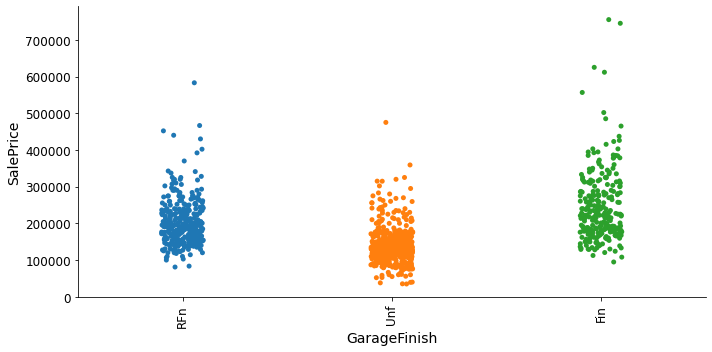

In [99]:
sns.catplot(x='GarageFinish',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('GarageFinish',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

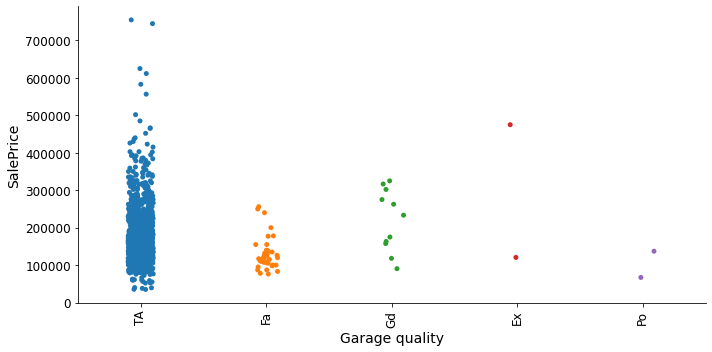

In [100]:
sns.catplot(x='GarageQual',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Garage quality',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

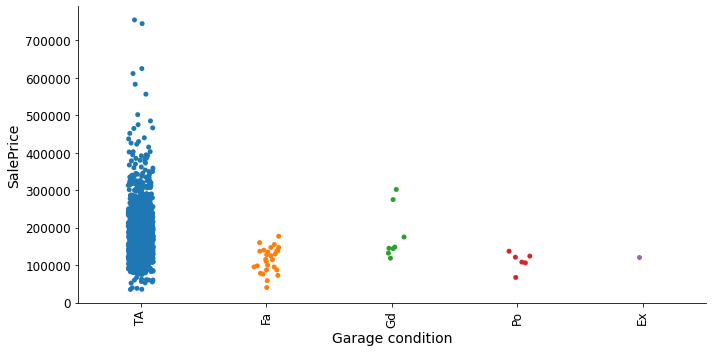

In [101]:
sns.catplot(x='GarageCond',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Garage condition',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

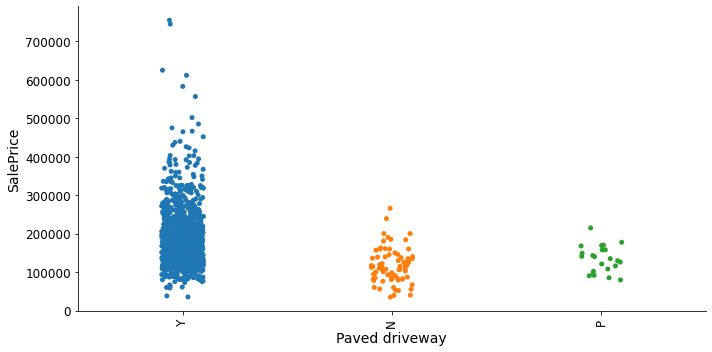

In [102]:
sns.catplot(x='PavedDrive',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Paved driveway',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

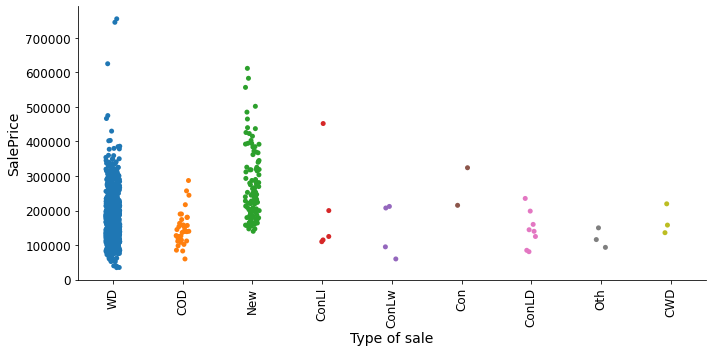

In [103]:
sns.catplot(x='SaleType',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Type of sale',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

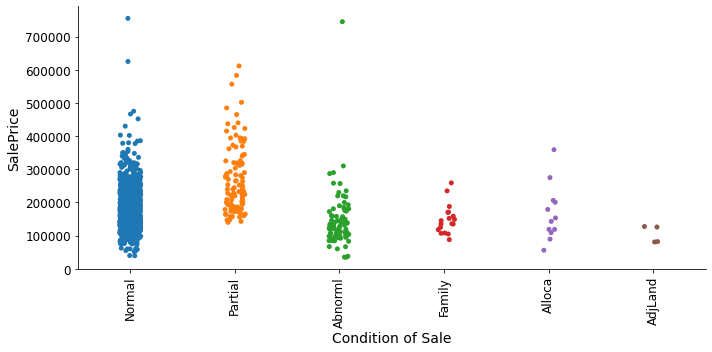

In [104]:
sns.catplot(x='SaleCondition',y='SalePrice',kind='strip',data=df,aspect=2)
plt.xlabel('Condition of Sale',fontsize=14)
plt.ylabel('SalePrice',fontsize=14)
plt.xticks(rotation=90,fontsize=12)
plt.yticks(rotation=0,fontsize=12)
plt.tight_layout()

In [105]:
cols=['MoSold', 'YrSold', 'SalePrice','SaleCondition']
data = df[cols]
data.head()

,MoSold,YrSold,SalePrice,SaleCondition
0,2,2007,128000,Normal
1,10,2007,268000,Normal
2,6,2007,269790,Normal
3,1,2010,190000,Normal
4,6,2009,215000,Normal


In [106]:
pd.pivot_table(data, index='SaleCondition')

,MoSold,SalePrice,YrSold
SaleCondition,,,
Abnorml,6.703704,147567.938272,2007.518519
AdjLand,6.250000,104125.000000,2006.750000
Alloca,5.666667,167377.416667,2008.166667
Family,6.333333,149138.888889,2007.111111
Normal,6.230688,175436.408466,2007.913228
Partial,7.148148,269585.231481,2007.185185


<AxesSubplot:ylabel='SaleCondition'>

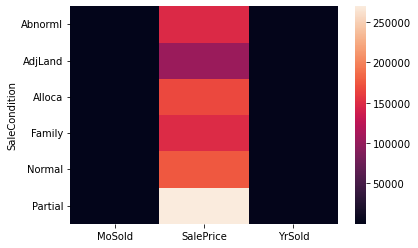

In [107]:
sns.heatmap(pd.pivot_table(data, index='SaleCondition',aggfunc='mean'))

In [108]:
col2=['BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','SaleCondition']
data2= df[col2]
data2.head(3)

,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,SaleCondition
0,120,0,958,1078,Normal
1,351,823,1043,2217,Normal
2,862,0,255,1117,Normal


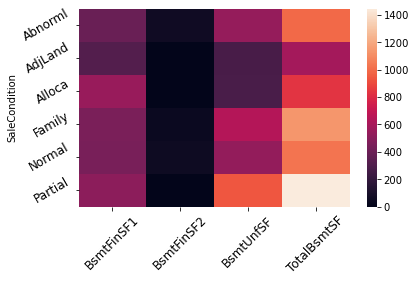

In [109]:
sns.heatmap(pd.pivot_table(data2, index='SaleCondition',aggfunc='mean'))
plt.xticks(rotation=45,fontsize=12)
plt.yticks(rotation=30,fontsize=12)
plt.tight_layout()

# Multivariate Graph

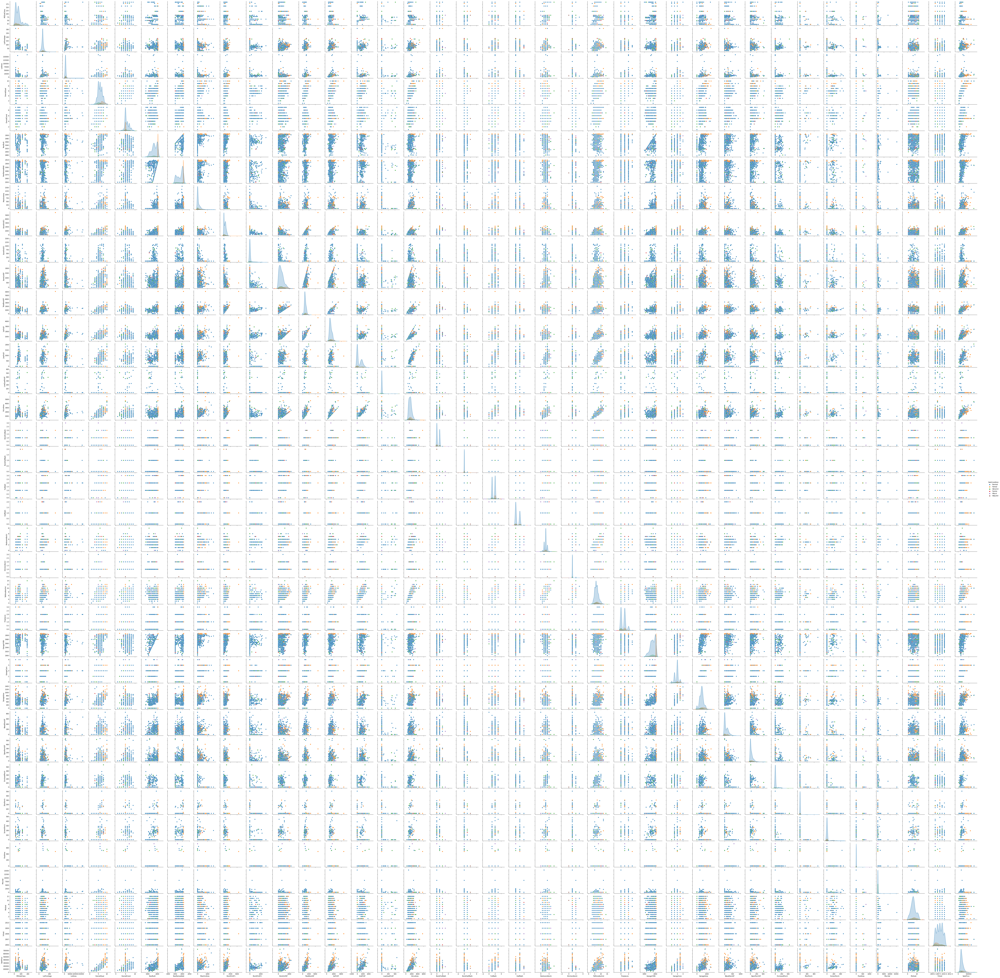

In [110]:
sns.pairplot(data=df,hue='SaleCondition')

In [111]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
for i in df.columns:
    if df[i].dtype=='object':
        df[i]=le.fit_transform(df[i])

# Descriptive Statistics

In [112]:
df.describe()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
count,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000
mean,56.767979,3.013699,70.807363,10484.749144,0.996575,1.938356,2.773973,3.004281,0.064212,12.145548,2.032534,2.005993,0.476027,3.043664,6.104452,5.595890,1970.930651,1984.758562,1.402397,1.086473,8.659247,9.363014,1.758562,101.696918,2.530822,3.725171,1.395548,2.282534,2.802226,2.273116,2.798801,444.726027,4.713185,46.647260,569.721747,1061.095034,1.035959,1.569349,0.933219,3.688356,1169.860445,348.826199,6.380137,1525.066781,0.425514,0.055651,1.562500,0.388699,2.884418,1.045377,2.328767,6.542808,5.742295,0.617295,2.389555,2.225171,1978.292808,1.233733,1.776541,476.860445,3.872432,3.905822,1.853596,96.206336,46.559932,23.015411,3.639555,15.051370,3.448630,47.315068,6.344178,2007.804795,7.465753,3.768836,181477.005993
std,41.940650,0.633120,22.440317,8957.442311,0.058445,1.412262,0.710027,1.642667,0.284088,6.010364,0.871703,0.250035,1.180870,1.898625,1.390153,1.124343,30.145255,20.785185,0.832539,0.642848,3.097443,3.462380,0.611174,182.218483,0.699425,0.744463,0.709379,0.857830,0.674746,1.144218,1.837839,462.664785,0.925186,163.520016,449.375525,442.272249,0.302078,1.749129,0.249749,1.042606,391.161983,439.696370,50.892844,528.042957,0.521615,0.236699,0.551882,0.504929,0.817229,0.216292,0.832992,1.598484,0.987250,0.650575,0.905923,1.767017,24.202053,0.809747,0.745554,214.466769,0.592724,0.503323,0.501894,126.158988,66.381023,63.191089,29.088867,55.080816,44.896939,543.264432,2.686352,1.329738,1.619459,1.112208,79105.586863
min,20.000000,0.000000,21.000000,1300.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1875.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,0.000000,0.000000,34900.000000
25%,20.000000,3.000000,60.000000,7621.500000,1.000000,0.000000,3.000000,2.000000,0.000000,7.000000,2.000000,2.000000,0.000000,2.00

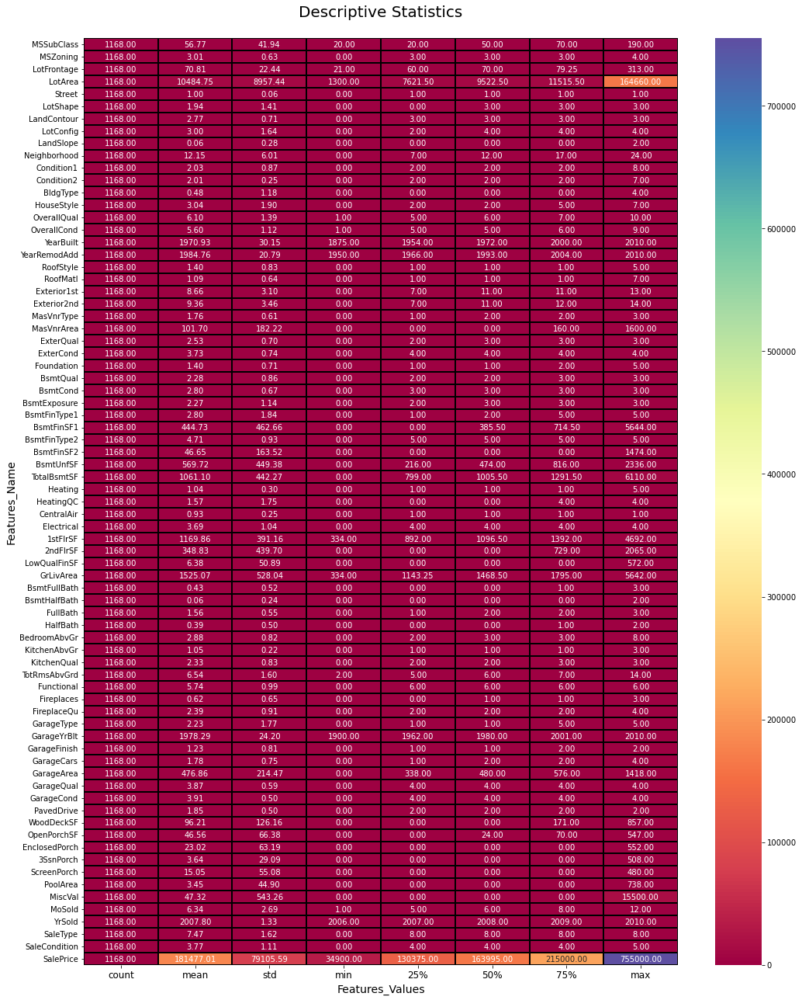

In [113]:
plt.figure(figsize=(15,18))
sns.heatmap(df.describe().T,annot=True,linewidth=0.02,linecolor='black',fmt='0.2f',cmap='Spectral')
plt.xlabel('Features_Values',fontsize=14)
plt.ylabel('Features_Name',fontsize=14)
plt.title('Descriptive Statistics\n',fontsize=20)
plt.xticks(rotation=0,fontsize=12)
plt.tight_layout()

# Few Observations:

- Null Values: No Null Values

- Right Skewed: MSSubClass,LotFrontage, LotArea, MasVnrArea, BsmtFinSF1, BsmtFinSF2, BsmtUnfSF, TotalBsmtSF, 1stFlrSF, 2ndFlrSF, LowQualFinSF, GrLivArea

- Left Skewed: OverallQual, YearBuilt, YearRemodAdd
- Standard Deviation: SalePrice, MiscVal, GarageArea, WoodDeckSF, OpenPorchSF, YearBuilt, YearRemodAdd, MasVnrArea,BsmtFinSF1,	BsmtFinSF2,	BsmtUnfSF, TotalBsmtSF,	1stFlrSF, 2ndFlrSF,	LowQualFinSF

- Outliers: BsmtFinSF1, BsmtFinSF2, BsmtUnfSF, TotalBsmtSF, 1stFlrSF,	2ndFlrSF, LowQualFinSF,	GrLivArea, WoodDeckSF, OpenPorchSF,	EnclosedPorch, 3SsnPorch, ScreenPorch, PoolArea, MiscVal, MoSold, YrSold, SalePrice

# Correlation Graph

In [114]:
df.corr()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
MSSubClass,1.000000,0.007478,-0.336234,-0.124151,-0.035981,0.104485,-0.021387,0.076880,-0.014930,0.013918,-0.042474,-0.044319,0.731815,0.381585,0.070462,-0.056978,0.023988,0.056618,-0.100641,-0.032214,-0.090178,-0.120022,-0.013252,0.028215,-0.024133,0.004186,0.053951,-0.052242,-0.013220,-0.068192,0.017515,-0.052236,0.040573,-0.062403,-0.134170,-0.214042,0.047734,-0.001994,-0.113883,0.045533,-0.227927,0.300366,0.053737,0.086448,0.004556,0.008207,0.140807,0.168423,-0.013283,0.283506,-0.011378,0.051179,0.022913,-0.035792,0.024708,0.077469,0.074640,-0.000067,-0.027639,-0.092408,-0.010568,-0.025595,-0.068702,-0.022609,0.017468,-0.004252,-0.043210,-0.013291,0.009583,-0.023503,-0.016015,-0.038595,0.035050,-0.028981,-0.060775
MSZoning,0.007478,1.000000,-0.069476,-0.023328,0.140215,0.053655,0.001175,-0.027246,-0.023952,-0.251833,-0.025651,0.031959,-0.024776,-0.110991,-0.134037,0.189553,-0.299732,-0.174586,0.000913,0.009719,-0.012037,0.005548,-0.033521,-0.059170,0.184815,-0.099269,-0.244844,0.123822,0.002336,0.037414,0.021518,-0.034161,-0.031322,0.027055,-0.032638,-0.058896,0.051188,0.119852,-0.015887,-0.079205,-0.033095,-0.048968,0.012098,-0.064125,-0.007287,0.006345,-0.188837,-0.121209,-0.001906,0.026744,0.111689,-0.031062,-0.091684,0.010658,0.005628,0.125155,-0.260416,0.162566,-0.126031,-0.168364,-0.168881,-0.087375,-0.077280,-0.004509,-0.152694,0.111221,0.004409,0.030793,-0.001663,0.003416,-0.051646,-0.004964,0.079854,0.004501,-0.133221
LotFrontage,-0.336234,-0.069476,1.000000,0.296790,-0.035131,-0.138975,-0.073725,-0.189317,0.044283,0.066073,-0.026488,0.010896,-0.402558,0.055345,0.229981,-0.047851,0.112000,0.089513,0.146568,0.081703,0.088520,0.111287,-0.032509,0.188273,-0.170588,0.044890,0.090649,-0.177720,0.042190,-0.123731,-0.029634,0.227732,-0.006626,0.001253,0.115628,0.356180,-0.026282,-0.079376,0.076291,0.066544,0.402864,0.089816,0.008087,0.374000,0.092807,0.001375,0.171842,0.047149,0.236946,-0.002082,-0.175895,0.318941,0.039337,0.228494,0.070673,-0.214856,0.054459,-0.192233,0.260224,0.322750,0.040542,0.043306,0.091761,0.087267,0.151044,0.021103,0.050499,0.030440,0.195973,-0.002830,0.022579,-0.004162,-0.036081,0.065439,0.323851
LotArea,-0.124151,-0.023328,0.296790,1.000000,-0.263973,-0.189201,-0.159038,-0.152063,0.395410,0.010707,0.029520,0.040096,-0.215345,-0.040637,0.107188,0.017513,0.005506,0.027228,0.038615,0.194142,0.048265,0.027328,-0.005204,0.120192,-0.057865,0.011438,-0.021195,-0.075262,0.010165,-0.136900,-0.053584,0.221851,-0.084713,0.056656,0.006600,0.259733,-0.020394,-0.003337,0.051182,0.050388,0.312843,0.059803,-0.001915,0.281360,0.142387,0.059282,0.123197,0.007271,0.117351,-0.013075,-0.064278,0.184546,-0.033165,0.285983,0.112306,-0.123746,-0.036133,-0.117373,0.158313,0.195162,0.005999,0.035657,0.021907,0.216720,0.093080,-0.007446,0.025794,0.025256,0.097107,0.051679,0.015141,-0.035399,0.005421,0.034236,0.249499
Street,-0.035981,0.140215,-0.035131,-0.263973,1.000000,-0.012941,0.105226,0.000153,-0.141572,0.001420,0.002189,0.001406,-0.013606,0.016793,0.057140,0.031082,0.020292,0.057866,-0.006875,0.007889,0.012482,0.014618,0.000822,0.024363,0.044509,0.017738,0.032701,-0.031959,-0.017190,0.065253,-0.006420,-0.009066,0.04520

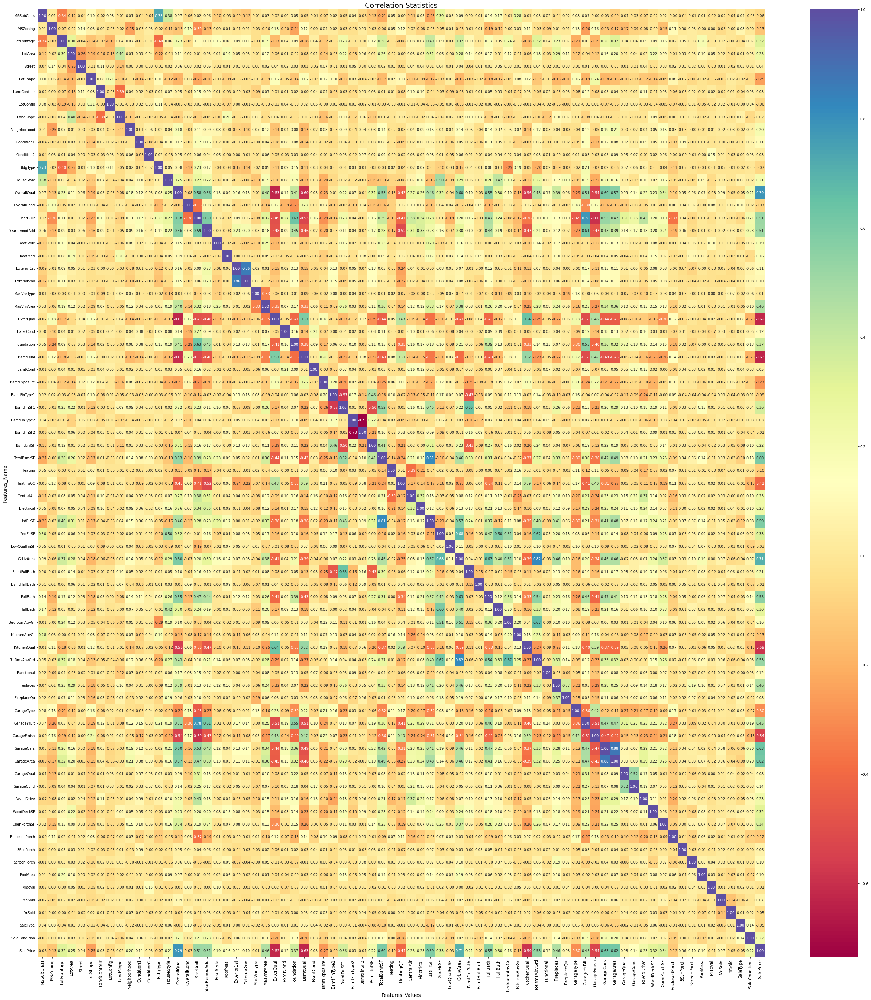

In [115]:
plt.figure(figsize=(38,40))
sns.heatmap(df.corr(),annot=True,linewidth=0.0,linecolor='black',fmt='0.2f',cmap='Spectral',square=False)
plt.xlabel('Features_Values',fontsize=14)
plt.ylabel('Features_Name',fontsize=14)
plt.title('Correlation Statistics',fontsize=20)
plt.xticks(rotation=90,fontsize=12)
plt.tight_layout()

In [116]:
print(round(df.corr()['SalePrice'].sort_values(),2))

BsmtQual        -0.63
ExterQual       -0.62
KitchenQual     -0.59
GarageFinish    -0.54
HeatingQC       -0.41
GarageType      -0.30
BsmtExposure    -0.27
LotShape        -0.25
MSZoning        -0.13
KitchenAbvGr    -0.13
EnclosedPorch   -0.12
Heating         -0.10
BsmtFinType1    -0.09
BldgType        -0.07
OverallCond     -0.07
MSSubClass      -0.06
LotConfig       -0.06
SaleType        -0.05
YrSold          -0.05
LowQualFinSF    -0.03
MiscVal         -0.01
BsmtHalfBath    -0.01
BsmtFinSF2      -0.01
MasVnrType       0.01
LandSlope        0.02
BsmtFinType2     0.03
LandContour      0.03
Condition2       0.03
Street           0.04
BsmtCond         0.05
3SsnPorch        0.06
MoSold           0.07
GarageQual       0.08
FireplaceQu      0.08
Exterior2nd      0.10
ScreenPorch      0.10
PoolArea         0.10
Condition1       0.11
Exterior1st      0.11
ExterCond        0.12
Functional       0.12
GarageCond       0.14
BedroomAbvGr     0.16
RoofMatl         0.16
RoofStyle        0.19
Neighborho

Text(0, 0.5, 'Feature_Scale')

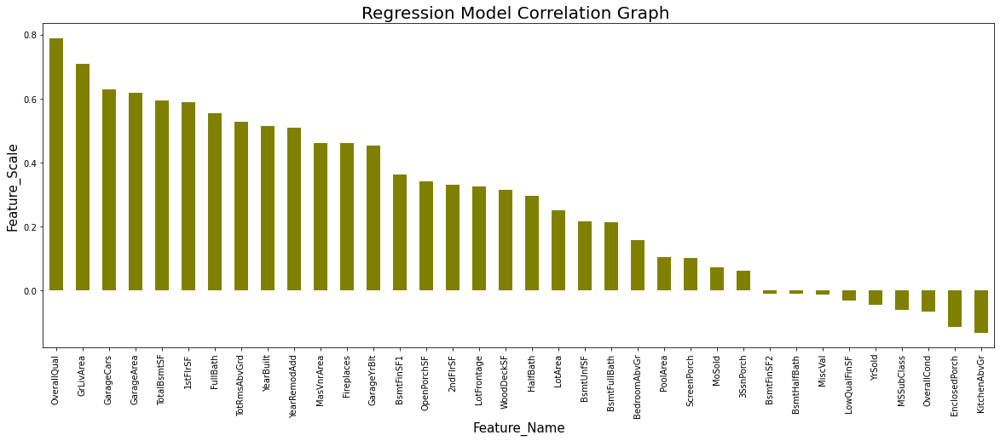

In [43]:
plt.figure(figsize=(20,7))
df.corr()['SalePrice'].sort_values(ascending=False).drop('SalePrice').plot(kind='bar',color='olive')
plt.title("Regression Model Correlation Graph ",fontsize=20)
plt.xlabel("Feature_Name",fontsize=15, loc='center')
plt.ylabel("Feature_Scale",fontsize=15, loc='center')

# Observation Shows:

- BsmtQual is 63 percent negtively correlated with the target variable
- ExterQual is 62 percent negatively correlated with the target variable.
- KitchenQual is 59 percent negatively correlated with the target variable
- GarageFinish is 54 percent negatively correlated with the target variable
- HeatingQC  is 41 percent negatively correlated with the target variable.
- GarageType  is 30 percent negatively correlated with the target variable.
- BsmtExposure is 27 percent negatively correlted with the target variable.
- LotShape  is 25 percentage negatively correlated with the target variable
- MSZoning  is 13 percentage negatively correlated with the target variable
- KitchenAbvGr is 13 percent negatively correlated with target Variable.
- EnclosedPorch is 12 percent negatively correlated with target Variable 
- OverallCond is 07 percent negatively correlated with target Variable
- MSSubClass  is 06 percent negatively correlated with target Variable
- YrSold is 05 percent negatively correlated with target Variable
- LowQualFinSF is 03 percent negatively correlated with target Variable
- MiscVal is 01 percent negatively correlated with target Variable
- BsmtHalfBath is 01 percent negatively correlated with target Variable
- BsmtFinSF2 is 01 percent negatively correlated with target Variable
- 3SsnPorch is 06 percent positively correlated with target Variable
- MoSold is 07 percent positively correlated with target Variable
- ScreenPorch is 10 percent positively correlated with target Variable
- PoolArea is 10 percent positively correlated with target Variable
- BedroomAbvGr is 16 percent positively correlated with target Variable
- BsmtFullBath is 21 percent positively correlated with target Variable
- BsmtUnfSF is 22 percent positively correlated with target Variable
- LotArea is 25 percent positively correlated with target Variable
- HalfBath is 30 percent positively correlated with target Variable
- WoodDeckSF is 32 percent positively correlated with target Variable
- LotFrontage is 32 percent positively correlated with target Variable
- 2ndFlrSF is 33 percent positively correlated with target Variable
- OpenPorchSF is 34 percent positively correlated with target Variable
- BsmtFinSF1 is 36 percent positively correlated with target Variable
- GarageYrBlt is 45 percent positively correlated with target Variable
- Fireplaces is 46 percent positively correlated with target Variable
- MasVnrArea is 46 percent positively correlated with target Variable
- YearRemodAdd is 51 percent positively correlated with target Variable
- YearBuilt is 51 percent positively correlated with target Variable
- TotRmsAbvGrd is 53 percent positively correlated with target Variable
- FullBath is 55 percent positively correlated with target Variable
- 1stFlrSF is 59 percent positively correlated with target Variable
- TotalBsmtSF is 60 percent positively correlated with target Variable
- GarageArea is 62 percent positively correlated with target Variable
- GarageCars is 63 percent positively correlated with target Variable
- GrLivArea is 71 percent positively correlated with target Variable
- OverallQual is 79 percent positively correlated with target Variable
- SalePrice 1.00  percent positively correlated with target Variable

--------------------------------------------------------------------------
Note:

- BsmtQual is very Negatively Correlated.
- QverallQual is 79 percentage positively correlated
- SalePrice is 100 percentage Positively correlated with SalesPrice

# Checking Outliers:

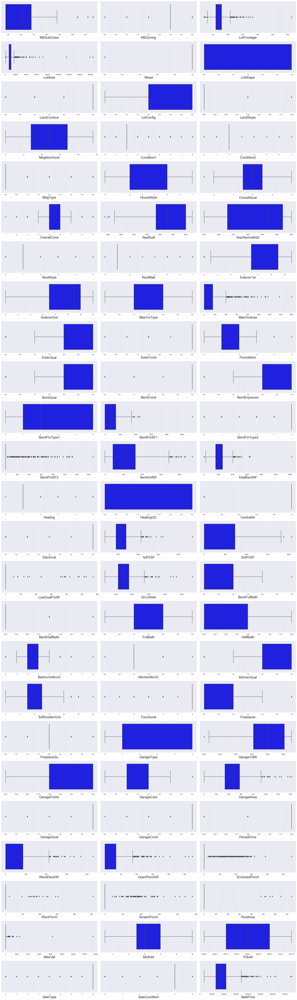

In [117]:
plt.figure(figsize=(25,100),facecolor='white',edgecolor='orange',)

plotnumber=1

for column in df:
    if plotnumber<=90 : 
        sns.set_style('darkgrid')
        ax=plt.subplot(30,3,plotnumber)
        sns.boxplot(df[column],color='blue')
        plt.xlabel(column , fontsize=20)
        
    plotnumber+=1
plt.tight_layout()

# Observation Shows

1. Shows Outliers:

MSSubClas,MSZoning,FotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Condition1,Condition2,BldgType,OverallQual,OverallCond,YearBuilt,RoofStyle,RoofMatl,Exterior1st,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure, BsmtFinSF1,BsmtFinType2,Heating,CentralAir, Electrical,1stFlrSF,2ndFleSF,LowQualFinSF,GrLivArea,BsmtFullBath, BsmtHAlfBath ,BedroomAbovGe, KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageCars, GarageArea,GarageQual,GarageCond,PavedDrive,WooddeckSF,PoolArea,SaleType,SaleCondition Shows outliers

2. Extream Outliers:

MasVnrArea,BsmtUnfSF,TotalBsmtSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,MiscVal,SalePrice Shows 


# Skewness

In [118]:
df.skew().sort_values()

Street          -17.021969
GarageCond       -5.422472
GarageQual       -4.582386
Functional       -3.999663
SaleType         -3.660513
BsmtFinType2     -3.615783
CentralAir       -3.475188
BsmtCond         -3.293554
PavedDrive       -3.274035
LandContour      -3.125982
Electrical       -3.104209
SaleCondition    -2.671829
ExterCond        -2.516219
ExterQual        -1.810843
MSZoning         -1.796785
KitchenQual      -1.408106
BsmtQual         -1.343781
BsmtExposure     -1.166987
LotConfig        -1.118821
GarageYrBlt      -0.674913
Exterior1st      -0.612816
LotShape         -0.603775
Exterior2nd      -0.592349
YearBuilt        -0.579204
YearRemodAdd     -0.495864
GarageFinish     -0.450190
GarageCars       -0.358556
MasVnrType       -0.104609
BsmtFinType1     -0.068901
Foundation       -0.002761
Neighborhood      0.043735
FullBath          0.057809
YrSold            0.115765
OverallQual       0.175082
GarageArea        0.189665
MoSold            0.220979
BedroomAbvGr      0.243855
H

Skewness Normal is between(+/- 65)
---------------------------------------------------

### These Columns Shows Skewness to be more than  +-65

- Street          -17.021969
- GarageCond       -5.422472
- GarageQual       -4.582386
- Functional       -3.999663
- SaleType         -3.660513
- BsmtFinType2     -3.615783
- CentralAir       -3.475188
- BsmtCond         -3.293554
- PavedDrive       -3.274035
- LandContour      -3.125982
- Electrical       -3.104209
- SaleCondition    -2.671829
- ExterCond        -2.516219
- ExterQual        -1.810843
- MSZoning         -1.796785
- KitchenQual      -1.408106
- BsmtQual         -1.343781
- BsmtExposure     -1.166987
- LotConfig        -1.118821
- GarageYrBlt      -0.674913
- HalfBath          0.656492
- Fireplaces        0.671966
- FireplaceQu       0.753507
- 2ndFlrSF          0.823479
- GarageType        0.831142
- BsmtUnfSF         0.909057
- MSSubClass        1.422019
- GrLivArea         1.449952
- RoofStyle         1.498560
- WoodDeckSF        1.504929
- 1stFlrSF          1.513707
- TotalBsmtSF       1.744591
- BsmtFinSF1        1.871606
- SalePrice         1.953878
- BldgType          2.318657
- OpenPorchSF       2.410840
- LotFrontage       2.733440
- MasVnrArea        2.835718
- Condition1        3.008289
- EnclosedPorch     3.043610
- ScreenPorch       4.105741
- BsmtHalfBath      4.264403
- KitchenAbvGr      4.365259
- BsmtFinSF2        4.365829
- LandSlope         4.812568
- RoofMatl          7.577352
- LowQualFinSF      8.666142
- 3SsnPorch         9.770611
- Heating          10.103609
- LotArea          10.659285
- Condition2       11.514458
- PoolArea         13.243711
- MiscVal          23.065943

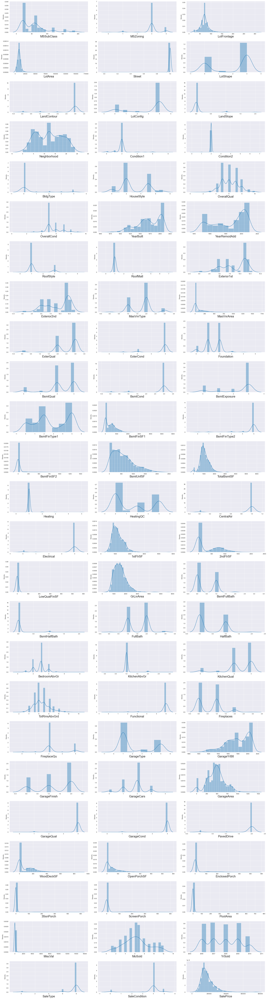

In [119]:
plt.figure(figsize=(25,100),facecolor='white')
plotnumber = 1

for column in df:
    if plotnumber<=81:
        ax=plt.subplot(27,3,plotnumber)
        sns.distplot(df[column])
        plt.xlabel(column,fontsize=20)
        
    plotnumber+=1
plt.tight_layout()

## Observation Shows:

- Maximum Graph lies beyond the normal Graph,
- Graph contains models that are Bi-Model,Tri-Modal and Multi-Modal Graph.
- Graph Shows Right and Left Skewness

# Data Cleansing

In [120]:
print(round(df.corr()['SalePrice'].sort_values(),2))

BsmtQual        -0.63
ExterQual       -0.62
KitchenQual     -0.59
GarageFinish    -0.54
HeatingQC       -0.41
GarageType      -0.30
BsmtExposure    -0.27
LotShape        -0.25
MSZoning        -0.13
KitchenAbvGr    -0.13
EnclosedPorch   -0.12
Heating         -0.10
BsmtFinType1    -0.09
BldgType        -0.07
OverallCond     -0.07
MSSubClass      -0.06
LotConfig       -0.06
SaleType        -0.05
YrSold          -0.05
LowQualFinSF    -0.03
MiscVal         -0.01
BsmtHalfBath    -0.01
BsmtFinSF2      -0.01
MasVnrType       0.01
LandSlope        0.02
BsmtFinType2     0.03
LandContour      0.03
Condition2       0.03
Street           0.04
BsmtCond         0.05
3SsnPorch        0.06
MoSold           0.07
GarageQual       0.08
FireplaceQu      0.08
Exterior2nd      0.10
ScreenPorch      0.10
PoolArea         0.10
Condition1       0.11
Exterior1st      0.11
ExterCond        0.12
Functional       0.12
GarageCond       0.14
BedroomAbvGr     0.16
RoofMatl         0.16
RoofStyle        0.19
Neighborho

### Deleting these rows as:

- BsmtQual        -0.63 very negative relation.

#### Deleting those rows as these rows shows no good relation or its close to Zero

- MiscVal         -0.01
- BsmtHalfBath    -0.01
- BsmtFinSF2      -0.01
- MasVnrType       0.01
- LandSlope        0.02

In [121]:
delete=pd.DataFrame(data={'Columns':['BsmtQual','MiscVal','BsmtHalfBath','BsmtFinSF2','MasVnrType','LandSlope'],
                            'Values':[-0.63,-0.01, -0.01, -0.01, 0.01, 0.02],
                            'Outliers':['Yes','Yes','Yes','yes','Yes','Yes'],'Normalised':['No','No','No','No',"NO",'No']})
delete

,Columns,Values,Outliers,Normalised
0,BsmtQual,-0.63,Yes,No
1,MiscVal,-0.01,Yes,No
2,BsmtHalfBath,-0.01,Yes,No
3,BsmtFinSF2,-0.01,yes,No
4,MasVnrType,0.01,Yes,NO
5,LandSlope,0.02,Yes,No


In [122]:
df.drop(['BsmtQual','MiscVal','BsmtHalfBath','BsmtFinSF2','MasVnrType','LandSlope'],axis=1,inplace=True)

# Removing Outliers

In [123]:
from scipy.stats import zscore

z=np.abs(zscore(df))
z.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1.508301,0.021646,0.035994,0.620616,0.058621,1.373107,0.318473,0.606420,0.142224,0.037339,0.023979,2.985495,0.549930,0.075169,0.530217,0.168236,0.421565,0.483544,0.134573,0.212927,0.104890,0.558343,0.671093,0.369322,0.557836,0.293234,0.635539,1.523529,0.702161,0.310141,0.864410,0.038239,0.11909,1.390230,0.267506,0.299036,0.541850,0.793674,0.125418,1.074363,0.816112,0.793082,0.770138,1.082679,0.209883,0.806154,0.965583,0.261146,0.588509,1.778446,0.693653,0.053440,0.288773,0.29985,0.171944,0.215316,0.187193,0.291828,0.762907,2.387850,0.364375,0.125172,0.273377,0.076845,1.617822,0.605487,0.330033,0.207932,0.676310
1,0.877042,0.021646,1.078550,0.600903,0.058621,1.373107,0.318473,0.606420,0.024227,0.037339,0.023979,0.403288,0.549930,1.364138,0.359572,0.030885,0.710356,1.685203,6.090408,1.079014,1.050880,0.558343,0.759266,2.318331,0.852451,2.672114,1.113129,1.523529,0.202665,0.771186,1.053642,2.614679,0.11909,0.897602,0.267506,0.299036,2.678144,0.793674,0.125418,1.310934,1.101833,0.793082,0.770138,1.365664,0.209883,0.394851,0.911999,0.261146,0.588509,1.778446,0.693653,0.342796,0.946709,0.29985,0.672371,0.215316,0.187193,0.291828,0.120585,2.417992,0.364375,0.125172,3.795117,0.076845,1.361470,0.605487,0.330033,0.207932,1.094234
2,0.077095,0.021646,0.944805,0.063075,0.058621,1.373107,0.318473,1.220661,0.475125,0.037339,0.023979,0.403288,1.030838,0.644484,0.530217,0.831975,0.589202,0.483544,0.134573,0.535912,0.682775,0.558343,0.759266,0.369322,0.852451,0.293234,1.987463,0.434828,0.902279,0.310141,0.700654,0.126458,0.11909,0.897602,0.267506,0.299036,0.109619,1.222216,0.125418,0.924437,1.101833,0.793082,1.211186,0.141492,0.209883,0.806154,0.911999,0.261146,0.588509,1.778446,0.693653,0.773290,0.946709,0.29985,0.101973,0.215316,0.187193,0.291828,0.664476,1.257525,0.364375,0.125172,0.273377,0.076845,0.128176,0.605487,0.330033,0.207932,1.116872
3,0.877042,0.021646,1.524367,0.141424,0.058621,1.373107,0.318473,0.606420,0.308675,0.037339,0.023979,0.403288,0.549930,0.075169,0.359572,0.201423,0.373434,1.919773,0.134573,0.212927,0.104890,2.076985,0.671093,0.369322,0.557836,0.293234,0.635539,0.979178,0.562795,0.310141,1.267363,1.770946,0.11909,0.897602,0.267506,0.299036,1.724166,0.793674,0.125418,0.604250,0.816112,0.793082,0.770138,0.141492,0.209883,0.806154,0.286138,0.261146,0.588509,1.778446,0.693653,0.053440,0.288773,0.29985,0.322517,0.215316,0.187193,0.291828,0.762907,1.136957,0.364375,0.125172,0.273377,0.076845,1.990233,1.651563,4.612004,0.207932,0.107788
4,0.877042,0.021646,0.035994,0.686902,0.058621,1.373107,0.318473,0.611634,0.308675,0.037339,0.023979,0.403288,0.549930,0.075169,1.249361,0.201423,0.733598,0.483544,0.134573,1.504868,1.549602,0.133430,0.759266,0.369322,0.557836,0.293234,0.635539,1.523529,1.732609,0.310141,0.475801,1.223537,0.11909,0.246314,0.267506,0.299036,1.105232,0.793674,0.125418,0.145757,0.816112,0.793082,0.770138,0.141492,0.209883,0.394851,0.911999,0.261146,0.588509,1.778446,0.693653,0.053440,1.524255,0.29985,0.243217,0.215316,0.187193,0.291828,1.140270,0.701705,0.364375,0.125172,0.273377,0.076845,0.128176,0.899213,0.330033,0.207932,0.423957


In [124]:
np.where(z>3) # Z greater

(array([   1,    1,    3, ..., 1166, 1166, 1166], dtype=int64),
 array([18, 62, 66, ..., 34, 56, 57], dtype=int64))

In [125]:
z.iloc[1,18]

6.09040757742434

In [126]:
new_df=df[(z<3).all(axis=1)]

# Data Loss Percentage

In [127]:
print("Old DataFrame",df.shape[0])
print("New DataFrame",new_df.shape[0])
print("Total_Dropped_rows",df.shape[0]-new_df.shape[0])

Old DataFrame 1168
New DataFrame 534
Total_Dropped_rows 634


In [128]:
print('Data Loss Percentage ',((df.shape[0]-new_df.shape[0])/df.shape[0])*100)

Data Loss Percentage  54.28082191780822


In [129]:
new_df

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,3,70.0,4928,1,0,3,4,13,2,2,4,2,6,5,1976,1976,1,1,8,9,0.0,3,4,1,3,3,0,120,5,958,1078,1,4,1,4,958,0,0,958,0,2,0,2,1,3,5,6,1,4,1,1977.0,1,2,440,4,4,2,0,205,0,0,0,0,2,2007,8,4,128000
2,60,3,92.0,9920,1,0,3,1,15,2,2,0,5,7,5,1996,1997,1,1,7,7,0.0,2,4,2,3,0,2,862,5,255,1117,1,0,1,4,1127,886,0,2013,1,2,1,3,1,3,8,6,1,4,1,1997.0,2,2,455,4,4,2,180,130,0,0,0,0,6,2007,8,4,269790
4,20,3,70.0,16635,1,0,3,2,14,2,2,0,2,6,7,1977,2000,1,1,4,4,126.0,2,4,1,3,3,0,1246,5,356,1602,1,2,1,4,1602,0,0,1602,0,2,0,3,1,2,8,6,1,4,1,1977.0,0,2,529,4,4,2,240,0,0,0,0,0,6,2009,8,4,215000
5,60,3,58.0,14054,1,0,3,4,8,2,2,0,5,7,5,2006,2006,1,1,11,12,0.0,2,4,2,3,0,5,0,5,879,879,1,0,1,4,879,984,0,1863,0,2,1,4,1,2,9,6,1,2,3,2006.0,0,3,660,4,4,2,100,17,0,0,0,0,11,2006,6,5,219210
6,20,3,70.0,11341,1,0,3,4,19,2,2,0,2,5,6,1957,1996,3,1,12,13,180.0,3,4,1,3,3,0,1302,5,90,1392,1,4,1,4,1392,0,0,1392,1,1,1,3,1,3,5,4,1,2,5,1957.0,2,2,528,4,4,2,0,0,0,0,95,0,5,2010,8,4,121500
11,60,3,44.0,9548,1,0,3,1,5,2,2,0,5,7,6,2003,2003,1,1,11,12,223.0,2,4,2,3,3,2,483,5,458,941,1,0,1,4,941,888,0,1829,1,2,1,3,1,2,7,6,1,4,1,2003.0,1,2,613,4,4,2,192,39,0,0,0,0,1,2010,8,4,237000
12,20,3,129.0,9196,1,0,3,4,11,2,2,0,2,7,5,2003,2003,1,1,11,12,0.0,2,4,2,3,3,5,0,5,1560,1560,1,0,1,4,1560,0,0,1560,0,2,0,3,1,2,7,6,0,2,1,2003.0,0,2,573,4,4,2,100,150,0,0,0,0,4,2010,8,4,201000
16,30,4,70.0,5890,1,3,3,0,9,2,2,0,2,6,8,1930,2007,1,1,12,13,0.0,2,2,0,3,0,0,538,5,278,816,1,0,1,4,816,0,0,816,0,1,0,2,1,3,5,6,0,2,5,2002.0,2,1,432,4,4,2,0,0,96,0,0,0,6,2008,8,4,120500
17,20,3,64.0,7314,1,3,3,4,5,2,2,0,2,7,5,2007,2007,1,1,11,12,82.0,2,4,2,3,0,2,724,5,508,1232,1,0,1,4,1232,0,0,1232,1,2,0,2,1,2,6,6,0,2,1,2007.0,1,2,632,4,4,2,132,0,0,0,0,0,2,2009,8,4,194500
19,160,4,24.0,2016,1,3,3,4,2,2,2,4,5,5,5,1970,1970,1,1,5,5,304.0,3,4,1,3,3,5,0,5,630,630,1,4,1,4,630,672,0,1302,0,2,1,3,1,3,6,6,0,2,5,1970.0,2,2,440,4,4,2,0,0,0,0,0,0,4,2007,8,4,106000


In [130]:
# we can't afford to loose 54 percentage of data we will use classification model

In [140]:
y=df.iloc[:,-1]

In [141]:
x=df.iloc[:,:-1]

In [142]:
y.shape

(1168,)

In [143]:
y.head()

0    128000
1    268000
2    269790
3    190000
4    215000
Name: SalePrice, dtype: int64

In [144]:
x.shape

(1168, 68)

In [145]:
x.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,SaleType,SaleCondition
0,120,3,70.0,4928,1,0,3,4,13,2,2,4,2,6,5,1976,1976,1,1,8,9,0.0,3,4,1,3,3,0,120,5,958,1078,1,4,1,4,958,0,0,958,0,2,0,2,1,3,5,6,1,4,1,1977.0,1,2,440,4,4,2,0,205,0,0,0,0,2,2007,8,4
1,20,3,95.0,15865,1,0,3,4,12,2,2,0,2,8,6,1970,1970,0,5,12,13,0.0,2,2,2,1,1,0,351,4,1043,2217,1,0,1,4,2217,0,0,2217,1,2,0,4,1,2,8,6,1,4,1,1970.0,2,2,621,4,4,2,81,207,0,0,224,0,10,2007,8,4
2,60,3,92.0,9920,1,0,3,1,15,2,2,0,5,7,5,1996,1997,1,1,7,7,0.0,2,4,2,3,0,2,862,5,255,1117,1,0,1,4,1127,886,0,2013,1,2,1,3,1,3,8,6,1,4,1,1997.0,2,2,455,4,4,2,180,130,0,0,0,0,6,2007,8,4
3,20,3,105.0,11751,1,0,3,4,14,2,2,0,2,6,6,1977,1977,3,1,8,9,480.0,3,4,1,3,3,1,705,5,1139,1844,1,0,1,4,1844,0,0,1844,0,2,0,3,1,3,7,6,1,4,1,1977.0,1,2,546,4,4,2,0,122,0,0,0,0,1,2010,0,4
4,20,3,70.0,16635,1,0,3,2,14,2,2,0,2,6,7,1977,2000,1,1,4,4,126.0,2,4,1,3,3,0,1246,5,356,1602,1,2,1,4,1602,0,0,1602,0,2,0,3,1,2,8,6,1,4,1,1977.0,0,2,529,4,4,2,240,0,0,0,0,0,6,2009,8,4


# Checking Multicolinarity

In [146]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calc_vif(x):
    vif=pd.DataFrame()
    vif['Variable']=x.columns
    vif['VIF Factors']=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    return vif

calc_vif(x)

,Variable,VIF Factors
0,MSSubClass,1.405760e+01
1,MSZoning,3.195270e+01
2,LotFrontage,1.931238e+01
3,LotArea,3.687873e+00
4,Street,3.460641e+02
5,LotShape,3.635429e+00
6,LandContour,1.894004e+01
7,LotConfig,5.033838e+00
8,Neighborhood,6.306434e+00
9,Condition1,7.360910e+00


In [148]:
df.columns

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'LotConfig', 'Neighborhood', 'Condition1',
       'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr',
       'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd', 'Functional',
       'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch',
       'ScreenPorch', 'PoolArea', 'MoSold'

# Removing Skewness

In [149]:
from sklearn.preprocessing import power_transform

x=power_transform(x,method='yeo-johnson')

In [155]:
x=pd.DataFrame(data=x,columns=['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'LotConfig', 'Neighborhood', 'Condition1',
       'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr',
       'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd', 'Functional',
       'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch',
       'ScreenPorch', 'PoolArea', 'MoSold', 'YrSold', 'SaleType',
       'SaleCondition'])

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1168 entries, 0 to 1167
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1168 non-null   int64  
 1   MSSubClass     1168 non-null   int64  
 2   MSZoning       1168 non-null   object 
 3   LotFrontage    954 non-null    float64
 4   LotArea        1168 non-null   int64  
 5   Street         1168 non-null   object 
 6   Alley          77 non-null     object 
 7   LotShape       1168 non-null   object 
 8   LandContour    1168 non-null   object 
 9   Utilities      1168 non-null   object 
 10  LotConfig      1168 non-null   object 
 11  LandSlope      1168 non-null   object 
 12  Neighborhood   1168 non-null   object 
 13  Condition1     1168 non-null   object 
 14  Condition2     1168 non-null   object 
 15  BldgType       1168 non-null   object 
 16  HouseStyle     1168 non-null   object 
 17  OverallQual    1168 non-null   int64  
 18  OverallC

In [152]:
x.skew().sort_values()

Street          -17.021969
RoofMatl         -6.314987
GarageCond       -4.925781
Heating          -4.541694
GarageQual       -4.327379
CentralAir       -3.475188
Functional       -3.343664
BsmtCond         -3.025865
PavedDrive       -3.025809
Electrical       -3.006845
LandContour      -2.592303
BsmtFinType2     -2.420885
KitchenAbvGr     -2.370593
ExterCond        -2.270791
SaleType         -2.067563
LotConfig        -1.030401
BsmtExposure     -0.914214
ExterQual        -0.605112
LotShape         -0.594207
KitchenQual      -0.435558
BsmtFinSF1       -0.404528
SaleCondition    -0.353292
Exterior2nd      -0.352793
Exterior1st      -0.338023
GarageFinish     -0.335248
GarageArea       -0.320370
RoofStyle        -0.292233
BsmtUnfSF        -0.284390
YearRemodAdd     -0.225131
BsmtFinType1     -0.206639
Neighborhood     -0.146541
GarageYrBlt      -0.136293
YearBuilt        -0.126641
HouseStyle       -0.080331
FullBath         -0.045944
MoSold           -0.035838
GarageCars       -0.022970
O

In [158]:
x.drop(['Street','RoofMatl','GarageCond','Heating','GarageQual','CentralAir','Functional','BsmtCond','PavedDrive',
         'Electrical','LandContour','BsmtFinType2','KitchenAbvGr','ExterCond','SaleType','LotConfig','BsmtExposure',
         'BldgType','EnclosedPorch','ScreenPorch','LowQualFinSF', '3SsnPorch', 'PoolArea'],axis=1,inplace=True)

In [159]:
x.skew().sort_values()

ExterQual       -0.605112
LotShape        -0.594207
KitchenQual     -0.435558
BsmtFinSF1      -0.404528
SaleCondition   -0.353292
Exterior2nd     -0.352793
Exterior1st     -0.338023
GarageFinish    -0.335248
GarageArea      -0.320370
RoofStyle       -0.292233
BsmtUnfSF       -0.284390
YearRemodAdd    -0.225131
BsmtFinType1    -0.206639
Neighborhood    -0.146541
GarageYrBlt     -0.136293
YearBuilt       -0.126641
HouseStyle      -0.080331
FullBath        -0.045944
MoSold          -0.035838
GarageCars      -0.022970
OpenPorchSF     -0.002749
1stFlrSF        -0.002391
GrLivArea       -0.000054
TotRmsAbvGrd     0.002332
Foundation       0.004296
OverallQual      0.021658
LotArea          0.032509
OverallCond      0.048063
MSSubClass       0.064007
FireplaceQu      0.082653
Fireplaces       0.084950
YrSold           0.112893
WoodDeckSF       0.113026
BedroomAbvGr     0.116498
LotFrontage      0.155904
HeatingQC        0.156511
GarageType       0.222501
Condition1       0.225468
MSZoning    

# Standard Scaler(Standardization)

In [160]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()

x=scaler.fit_transform(x)

In [161]:
x

array([[ 1.37043472, -0.16245555,  0.05732355, ..., -1.71943737,
        -0.60482475,  0.02973497],
       [-1.16799937, -0.16245555,  1.12585272, ...,  1.32061233,
        -0.60482475,  0.02973497],
       [ 0.4900471 , -0.16245555,  1.00784062, ..., -0.07674981,
        -0.60482475,  0.02973497],
       ...,
       [ 1.70079775, -0.16245555, -2.85855711, ...,  0.28887797,
         0.899557  ,  0.02973497],
       [ 0.69655685, -2.92646435, -0.9882638 , ...,  0.28887797,
         0.14805187,  0.02973497],
       [ 0.4900471 , -0.16245555,  0.05732355, ..., -0.07674981,
        -1.35902113,  0.02973497]])

In [163]:
print(" Mean Value ",round(x.mean(),2)," Standard Deviation ",round(x.std(),2))

 Mean Value  0.0  Standard Deviation  1.0


# Target Variable

In [164]:
y.unique()

array([128000, 268000, 269790, 190000, 215000, 219210, 121500, 155000,
       140000, 118500, 119500, 237000, 201000, 126500, 135500, 165000,
       120500, 194500, 148000, 106000, 231500, 133000, 142125, 136500,
       146000, 217000, 112000, 394432, 113000, 188700, 319900, 135000,
       128500, 169000, 122000, 152000, 243000, 156000,  79500, 132000,
       144152, 130000, 149900, 124500, 179000, 147000,  39300, 312500,
       256000,  60000, 153000,  84900, 230000, 180000, 106500, 239000,
       107500, 123000, 176000, 228500, 117500, 350000, 200624, 173000,
       225000,  84500, 174900,  79000, 297000,  87000, 465000, 204900,
       127000, 159000, 170000, 159500, 102000, 109500, 163990, 189950,
       119000, 157500, 287000, 144000, 286000, 172000, 212000, 124000,
       150000, 205950, 251000, 129000, 223500, 475000, 335000, 115000,
       205000, 209500, 176432, 171000, 302000, 259500, 141000, 187500,
       385000, 275000, 108000,  89500, 109900, 185000, 143000, 127500,
      

# However Values are in continous format we will use Linear Model

In [165]:
from sklearn.linear_model import LinearRegression
lr=LinearRegression()
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

### Finding Random State

In [166]:
for i in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(x,y,random_state=i,test_size=0.3)
    lr.fit(x_train,y_train)
    
    pred_train=lr.predict(x_train)
    pred_test=lr.predict(x_test)
    
    if round(r2_score(y_train,pred_train),2)==round(r2_score(y_test,pred_test),2):
        print(f"At random State {i},The r2 train score {r2_score(y_train,pred_train)}, r2 test score {r2_score(y_test,pred_test)}")

At random State 1,The r2 train score 0.8025949205042427, r2 test score 0.8041089173026522
At random State 14,The r2 train score 0.8014370159887209, r2 test score 0.804956706836083
At random State 26,The r2 train score 0.8022059227980998, r2 test score 0.800836112832869
At random State 39,The r2 train score 0.8005947852523426, r2 test score 0.8046031281208037
At random State 79,The r2 train score 0.8046091631319894, r2 test score 0.7982408867206201
At random State 83,The r2 train score 0.8032665731496759, r2 test score 0.8012159472334416
At random State 92,The r2 train score 0.8044139767751475, r2 test score 0.7979223752202316


# Linear Regression

In [170]:
#Train Test
x_train,x_test,y_train,y_test=train_test_split(x,y,random_state=39,test_size=0.3)

#training 
lr.fit(x_train,y_train)
lr_score=lr.score(x_train,y_train)

#predict
pred_train=lr.predict(x_train)
pred_test=lr.predict(x_test)

#result
print("Training Accuracy r2_score ",r2_score(y_train,pred_train)*100,"Testing Accuracy R2_score ",r2_score(y_test,pred_test)*100)
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  80.05947852523427 Testing Accuracy R2_score  80.46031281208037
Training Mean_squared_Error  1312036753.0209816 Testing Mean_squared_error  1069532970.1255641
Training Absolute_Error  22503.409961619203 Testing Absolute Error 21766.23416119535


In [171]:
print("Coefficient ",lr.coef_," Intercept ",lr.intercept_)

Coefficient  [-6208.9995657    322.9034267     96.22909429  6634.93715053
 -1311.4444352   1181.43378165 -2021.69573985 -3612.40995218
  1248.60373299 20088.92884133  5569.63827528  2495.42200497
 -1606.74793678   832.08340845  4147.90637067 -7323.64498644
   -67.0960056  -4438.24924641  1623.69976966  2175.22616713
  9545.42786903    78.21187828  3484.61552976 -2297.65856444
  4873.99882474  -235.20382469 16650.0007996   4589.45031085
  4453.31597596  6668.6207668  -5305.40011227 -8760.79129652
  4977.05982032  5822.51041795 -6681.75216919  2665.03853824
  2872.73443921  -878.30383088 12854.4541617  -6347.28978242
  2499.78962614  -374.7182706   -145.27123097 -1184.36453294
  1754.27973927]  Intercept  181442.9673524976


### Model Cross validation

In [172]:
from sklearn.model_selection import cross_val_score

#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,10):
    lr_cv_score=cross_val_score(lr,x,y,cv=i)
    cv_mean=lr_cv_score.mean()

    print(f"At CROSS_FOLD {i}, Cross_Val_Mean {cv_mean} ,Training Score is {train_accuracy}, Testing Score {test_accuracy}")

At CROSS_FOLD 2, Cross_Val_Mean 0.7597417004921494 ,Training Score is 0.8005947852523426, Testing Score 0.8046031281208037
At CROSS_FOLD 3, Cross_Val_Mean 0.7721317600238148 ,Training Score is 0.8005947852523426, Testing Score 0.8046031281208037
At CROSS_FOLD 4, Cross_Val_Mean 0.776045142200738 ,Training Score is 0.8005947852523426, Testing Score 0.8046031281208037
At CROSS_FOLD 5, Cross_Val_Mean 0.7725407017418534 ,Training Score is 0.8005947852523426, Testing Score 0.8046031281208037
At CROSS_FOLD 6, Cross_Val_Mean 0.7807865672637969 ,Training Score is 0.8005947852523426, Testing Score 0.8046031281208037
At CROSS_FOLD 7, Cross_Val_Mean 0.7631701930888609 ,Training Score is 0.8005947852523426, Testing Score 0.8046031281208037
At CROSS_FOLD 8, Cross_Val_Mean 0.7827306132461287 ,Training Score is 0.8005947852523426, Testing Score 0.8046031281208037
At CROSS_FOLD 9, Cross_Val_Mean 0.7650369826493677 ,Training Score is 0.8005947852523426, Testing Score 0.8046031281208037


In [173]:
# pred training for linear regression
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

#cross val with linear regression
lr_cv_score=cross_val_score(lr,x,y,cv=6) 
lr_mean=lr_cv_score.mean() #mean value

print("Cv_score of Model is ",lr_mean," The Training Score is ", train_accuracy," Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.7807865672637969  The Training Score is  0.8005947852523426  Testing Score Stands  0.8046031281208037


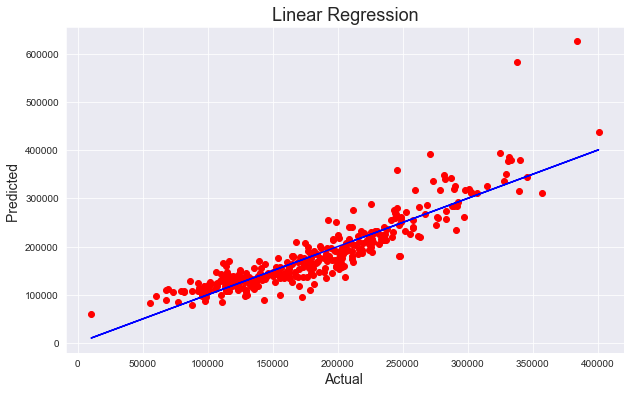

In [174]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='r')
plt.plot(pred_test,pred_test,color='b')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

In [175]:
from sklearn.linear_model import ElasticNet
# Elastic Net Model
en=ElasticNet()
en.fit(x_train,y_train)

# training score
en_score_training=en.score(x_train,y_train)
en_score_training*100

78.33111512402434

In [177]:
pred_en=en.predict(x_test) # predict test

en_cv_score=cross_val_score(en,x,y,cv=6)
en_cv_mean=en_cv_score.mean()
en_cv_mean

0.7797995528650219

### Working With Other Models

# Model- Decision Tree Regressor

In [178]:
from sklearn.tree import DecisionTreeRegressor
dtr=DecisionTreeRegressor()

#training Dtc model
dtr.fit(x_train,y_train)
dtr_score=dtr.score(x_train,y_train)

#predict dtc
pred_train=dtr.predict(x_train)
pred_test=dtr.predict(x_test)

#result dtc
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  1.0 Testing Accuracy R2_score  0.6928382304577889
Training Mean_squared_Error  0.0 Testing Mean_squared_error  1681294262.9430199
Training Absolute_Error  0.0 Testing Absolute Error 27434.327635327634


In [179]:
from sklearn.model_selection import cross_val_score

#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,10):
    dtr_cv_score=cross_val_score(dtr,x,y,cv=i)
    cv_mean=dtr_cv_score.mean()

    print(f"At CROSS_FOLD{i}, The Cross_Val_Score {cv_mean} ,The Training Score{train_accuracy}, Testing Score{test_accuracy}")

At CROSS_FOLD2, The Cross_Val_Score 0.6351589595493901 ,The Training Score1.0, Testing Score0.6928382304577889
At CROSS_FOLD3, The Cross_Val_Score 0.7219010955753631 ,The Training Score1.0, Testing Score0.6928382304577889
At CROSS_FOLD4, The Cross_Val_Score 0.699538119482297 ,The Training Score1.0, Testing Score0.6928382304577889
At CROSS_FOLD5, The Cross_Val_Score 0.7250597166824431 ,The Training Score1.0, Testing Score0.6928382304577889
At CROSS_FOLD6, The Cross_Val_Score 0.7374007772191691 ,The Training Score1.0, Testing Score0.6928382304577889
At CROSS_FOLD7, The Cross_Val_Score 0.6620216662612319 ,The Training Score1.0, Testing Score0.6928382304577889
At CROSS_FOLD8, The Cross_Val_Score 0.7459244981711782 ,The Training Score1.0, Testing Score0.6928382304577889
At CROSS_FOLD9, The Cross_Val_Score 0.7188247089037486 ,The Training Score1.0, Testing Score0.6928382304577889


In [180]:
#cross val with dtc
dtr_cv_score=cross_val_score(dtr,x,y,cv=8) 
dtr_mean=dtr_cv_score.mean() #mean value

print("Cv_score of Model is ",dtr_mean," The Training Score is ", train_accuracy," Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.7213424918300142  The Training Score is  1.0  Testing Score Stands  0.6928382304577889


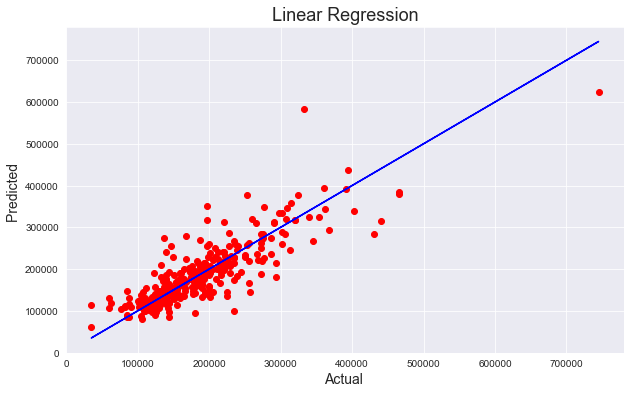

In [181]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='r')
plt.plot(pred_test,pred_test,color='b')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()


# KNeighbors Regressor

In [182]:
from sklearn.neighbors import KNeighborsRegressor
knr=KNeighborsRegressor()

#training knr model
knr.fit(x_train,y_train)
knr_score=knr.score(x_train,y_train)

#predict knr
pred_train=knr.predict(x_train)
pred_test=knr.predict(x_test)

#result knr
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  0.8179653611569416 Testing Accuracy R2_score  0.8149768922889767
Training Mean_squared_Error  1197742680.8382864 Testing Mean_squared_error  1012750675.2225641
Training Absolute_Error  19200.77747858017 Testing Absolute Error 20306.13333333333


In [183]:
#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,10):
    knr_cv_score=cross_val_score(knr,x,y,cv=i)
    cv_mean=knr_cv_score.mean()

    print(f"At CROSS_FOLD {i}, The Cross_Val_Mean {cv_mean} ,Training Score is {train_accuracy}, Testing Score{test_accuracy}")

At CROSS_FOLD 2, The Cross_Val_Mean 0.7452446437430889 ,Training Score is 0.8179653611569416, Testing Score0.8149768922889767
At CROSS_FOLD 3, The Cross_Val_Mean 0.7607985805345366 ,Training Score is 0.8179653611569416, Testing Score0.8149768922889767
At CROSS_FOLD 4, The Cross_Val_Mean 0.7632270982738147 ,Training Score is 0.8179653611569416, Testing Score0.8149768922889767
At CROSS_FOLD 5, The Cross_Val_Mean 0.753166379432604 ,Training Score is 0.8179653611569416, Testing Score0.8149768922889767
At CROSS_FOLD 6, The Cross_Val_Mean 0.7641216002509803 ,Training Score is 0.8179653611569416, Testing Score0.8149768922889767
At CROSS_FOLD 7, The Cross_Val_Mean 0.7420557172680387 ,Training Score is 0.8179653611569416, Testing Score0.8149768922889767
At CROSS_FOLD 8, The Cross_Val_Mean 0.7666918530519351 ,Training Score is 0.8179653611569416, Testing Score0.8149768922889767
At CROSS_FOLD 9, The Cross_Val_Mean 0.7365259283960583 ,Training Score is 0.8179653611569416, Testing Score0.8149768922

In [184]:
#cross val with k-Neighbors
knr_cv_score=cross_val_score(knr,x,y,cv=8) 
knr_mean=knr_cv_score.mean() #mean value

print("Cv_score of Model is ",knr_mean," The Training Score", train_accuracy," Testing Score Stands" ,test_accuracy)

Cv_score of Model is  0.7666918530519351  The Training Score 0.8179653611569416  Testing Score Stands 0.8149768922889767


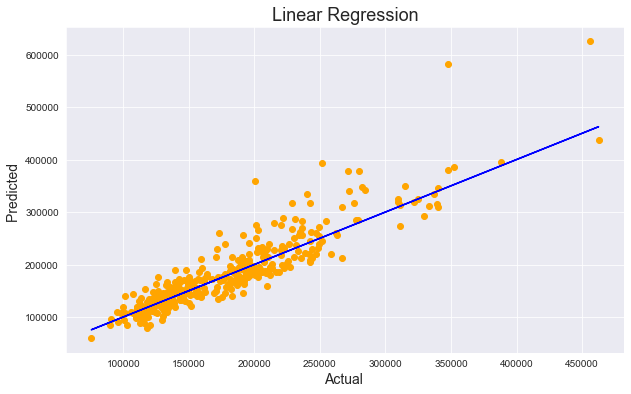

In [185]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='orange')
plt.plot(pred_test,pred_test,color='blue')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Model3: Support Vector Machine(Regressor)

In [186]:
from sklearn.svm import SVR
svr=SVR()

#training SVR
svr.fit(x_train,y_train)
svr_score=svr.score(x_train,y_train)

#predict SVR
pred_train = svr.predict(x_train)
pred_test  = svr.predict(x_test)

#result SVR
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  -0.05997081758574785 Testing Accuracy R2_score  -0.11207033931031973
Training Mean_squared_Error  6974344535.38301 Testing Mean_squared_error  6087077451.917714
Training Absolute_Error  56168.75574753584 Testing Absolute Error 53360.34687775143


In [187]:
from sklearn.model_selection import cross_val_score

#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,10):
    svr_cv_score=cross_val_score(svr,x,y,cv=i)
    cv_mean=svr_cv_score.mean()

    print(f"At CROSS_FOLD{i}, Cross_Val_Score{cv_mean} ,Training Score is {train_accuracy},Testing Score {test_accuracy} ")

At CROSS_FOLD2, Cross_Val_Score-0.0575111358728454 ,Training Score is -0.05997081758574785,Testing Score -0.11207033931031973 
At CROSS_FOLD3, Cross_Val_Score-0.05575502902485844 ,Training Score is -0.05997081758574785,Testing Score -0.11207033931031973 
At CROSS_FOLD4, Cross_Val_Score-0.05874811772811128 ,Training Score is -0.05997081758574785,Testing Score -0.11207033931031973 
At CROSS_FOLD5, Cross_Val_Score-0.06155637965248943 ,Training Score is -0.05997081758574785,Testing Score -0.11207033931031973 
At CROSS_FOLD6, Cross_Val_Score-0.05528623239629382 ,Training Score is -0.05997081758574785,Testing Score -0.11207033931031973 
At CROSS_FOLD7, Cross_Val_Score-0.055857700948524665 ,Training Score is -0.05997081758574785,Testing Score -0.11207033931031973 
At CROSS_FOLD8, Cross_Val_Score-0.05668667662677321 ,Training Score is -0.05997081758574785,Testing Score -0.11207033931031973 
At CROSS_FOLD9, Cross_Val_Score-0.054662757865483594 ,Training Score is -0.05997081758574785,Testing Sco

In [188]:
svr_cv_score=cross_val_score(svr,x,y,cv=3) 
svr_mean=svr_cv_score.mean() # cross val mean

print("Cv_score of Model is ",svr_mean," The Training Score is ",train_accuracy," Testing Score Stands " ,test_accuracy)

Cv_score of Model is  -0.05575502902485844  The Training Score is  -0.05997081758574785  Testing Score Stands  -0.11207033931031973


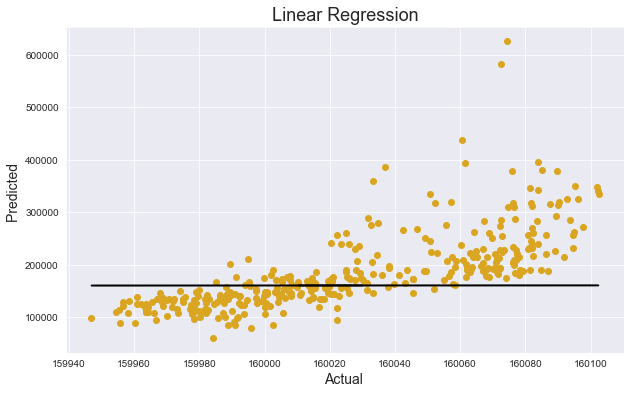

In [189]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='goldenrod')
plt.plot(pred_test,pred_test,color='black')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Model 4: SGD Regressor

In [190]:
from sklearn.linear_model import SGDRegressor
sgd=SGDRegressor()

#training SGD
sgd.fit(x_train,y_train)
sgd_score=sgd.score(x_train,y_train)

#predict
pred_train=sgd.predict(x_train)
pred_test=sgd.predict(x_test)

#result
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  0.7912771857354328 Testing Accuracy R2_score  0.8077433638091669
Training Mean_squared_Error  1373344242.0532358 Testing Mean_squared_error  1052344437.0115553
Training Absolute_Error  23842.931440963188 Testing Absolute Error 22965.797356126106


In [191]:
from sklearn.model_selection import cross_val_score

#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,10):
    sgd_cv_score=cross_val_score(sgd,x,y,cv=i)
    cv_mean=sgd_cv_score.mean()

    print(f"At CROSS_FOLD{i}, The Cross_Val_Score {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD2, The Cross_Val_Score 0.7607407955913978 ,Training Score is 0.7912771857354328,Testing Score0.8077433638091669
At CROSS_FOLD3, The Cross_Val_Score 0.7734364324178786 ,Training Score is 0.7912771857354328,Testing Score0.8077433638091669
At CROSS_FOLD4, The Cross_Val_Score 0.7775915789193548 ,Training Score is 0.7912771857354328,Testing Score0.8077433638091669
At CROSS_FOLD5, The Cross_Val_Score 0.7711999780983352 ,Training Score is 0.7912771857354328,Testing Score0.8077433638091669
At CROSS_FOLD6, The Cross_Val_Score 0.779683407981458 ,Training Score is 0.7912771857354328,Testing Score0.8077433638091669
At CROSS_FOLD7, The Cross_Val_Score 0.7682675758079325 ,Training Score is 0.7912771857354328,Testing Score0.8077433638091669
At CROSS_FOLD8, The Cross_Val_Score 0.7829937324387144 ,Training Score is 0.7912771857354328,Testing Score0.8077433638091669
At CROSS_FOLD9, The Cross_Val_Score 0.7639535561276399 ,Training Score is 0.7912771857354328,Testing Score0.8077433638091669


In [192]:
# As this Cross Fold 3 Cross_Val_Score is near to training score.

# pred training for SGD Regressor
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

#cross val with SGD Regressor
sgd_cv_score=cross_val_score(sgd,x,y,cv=8) 
sgd_mean=sgd_cv_score.mean() #mean value

print("Cv_score of Model is ",sgd_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.777771148298301  The Training Score is 0.7912771857354328 Testing Score Stands  0.8077433638091669


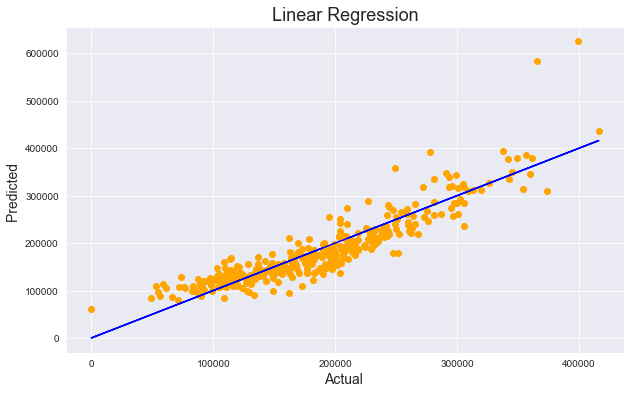

In [193]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='orange')
plt.plot(pred_test,pred_test,color='blue')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Ensemble Techniques (Bagging)

## Extra Trees Regressor

In [195]:
from sklearn.ensemble import ExtraTreesRegressor
etr=ExtraTreesRegressor()

#training score
etr.fit(x_train,y_train)
etr_score=etr.score(x_train,y_train)

#predict
pred_train=etr.predict(x_train)
pred_test=etr.predict(x_test)

#result
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  1.0 Testing Accuracy R2_score  0.8883907318199324
Training Mean_squared_Error  0.0 Testing Mean_squared_error  610909432.3882954
Training Absolute_Error  0.0 Testing Absolute Error 16106.224586894587


In [196]:
from sklearn.model_selection import cross_val_score

#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,20):
    etr_cv_score=cross_val_score(etr,x,y,cv=i)
    cv_mean=etr_cv_score.mean()

    print(f"At CROSS_FOLD{i}, The Cross_Val_Score {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD2, The Cross_Val_Score 0.8395894695522992 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_FOLD3, The Cross_Val_Score 0.8588124958208813 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_FOLD4, The Cross_Val_Score 0.8418828351362018 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_FOLD5, The Cross_Val_Score 0.8483477735676361 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_FOLD6, The Cross_Val_Score 0.8559236065195889 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_FOLD7, The Cross_Val_Score 0.8355311342072079 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_FOLD8, The Cross_Val_Score 0.8429219244681571 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_FOLD9, The Cross_Val_Score 0.8491252458998226 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_FOLD10, The Cross_Val_Score 0.8442069673596073 ,Training Score is 1.0,Testing Score0.8883907318199324
At CROSS_

In [197]:
# pred training for Extra Trees
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

#cross val with Extra Trees
etr_cv_score=cross_val_score(etr,x,y,cv=6) 
etr_mean=etr_cv_score.mean() #mean value

print("Cv_score of Model is ",etr_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.8541316998341034  The Training Score is 1.0 Testing Score Stands  0.8883907318199324


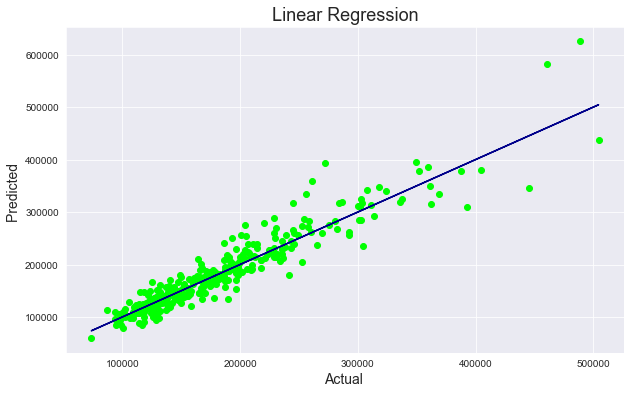

In [198]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='lime')
plt.plot(pred_test,pred_test,color='darkblue')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Random Forest Regressor

In [199]:
from sklearn.ensemble import RandomForestRegressor
rfr=RandomForestRegressor()

#training Random Forest
rfr.fit(x_train,y_train)
rfr_score= rfr.score(x_train,y_train)

#predict Model
pred_train = rfr.predict(x_train)
pred_test = rfr.predict(x_test)

#result
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  0.9757506397673887 Testing Accuracy R2_score  0.8844956981408182
Training Mean_squared_Error  159554763.413253 Testing Mean_squared_error  632229461.2070664
Training Absolute_Error  7125.065324357405 Testing Absolute Error 16607.458547008548


### Model Cross Validation Score

In [200]:
from sklearn.model_selection import cross_val_score

#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,10):
    rfr_cv_score=cross_val_score(rfr,x,y,cv=i)
    cv_mean=rfr_cv_score.mean()

    print(f"At CROSS_FOLD{i}, The Cross_Val_Score {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD2, The Cross_Val_Score 0.8287997359799384 ,Training Score is 0.9757506397673887,Testing Score0.8844956981408182
At CROSS_FOLD3, The Cross_Val_Score 0.8608284218337007 ,Training Score is 0.9757506397673887,Testing Score0.8844956981408182
At CROSS_FOLD4, The Cross_Val_Score 0.8391297155754436 ,Training Score is 0.9757506397673887,Testing Score0.8844956981408182
At CROSS_FOLD5, The Cross_Val_Score 0.8494631052290543 ,Training Score is 0.9757506397673887,Testing Score0.8844956981408182
At CROSS_FOLD6, The Cross_Val_Score 0.8585493891147182 ,Training Score is 0.9757506397673887,Testing Score0.8844956981408182
At CROSS_FOLD7, The Cross_Val_Score 0.8357356652424798 ,Training Score is 0.9757506397673887,Testing Score0.8844956981408182
At CROSS_FOLD8, The Cross_Val_Score 0.8529167817166041 ,Training Score is 0.9757506397673887,Testing Score0.8844956981408182
At CROSS_FOLD9, The Cross_Val_Score 0.8421129161254693 ,Training Score is 0.9757506397673887,Testing Score0.8844956981408182


### Selected Cross Fold 3, As Cross_Val_score is close Training Score

In [201]:
# pred training for Random Forest
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

#cross val with Random Forest
rfr_cv_score=cross_val_score(rfr,x,y,cv=3) 
rfr_mean=rfr_cv_score.mean()

print("Cv_score of Model is ",rfr_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.8585540399167999  The Training Score is 0.9757506397673887 Testing Score Stands  0.8844956981408182


### Model Graph Ploting 

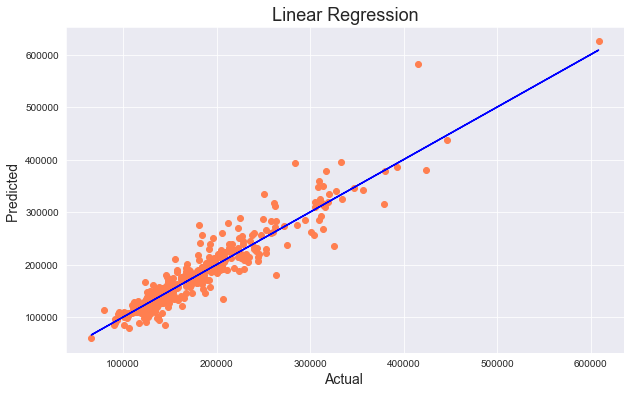

In [203]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='coral')
plt.plot(pred_test,pred_test,color='blue')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Ensemble Techniques (Boosting )

# Ada Boost

In [204]:
from sklearn.ensemble import AdaBoostRegressor
ada=AdaBoostRegressor()

#training_ada_Boost
ada.fit(x_train,y_train)
ada_score= ada.score(x_train,y_train)

#predict_ada_Boost
pred_train = ada.predict(x_train)
pred_test = ada.predict(x_test)

#result
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  0.8851108757631092 Testing Accuracy R2_score  0.8178854688058432
Training Mean_squared_Error  755941883.0242264 Testing Mean_squared_error  996830162.0075676
Training Absolute_Error  21510.982936854845 Testing Absolute Error 21850.992580548726


## Model Cross Validation Score

In [205]:
from sklearn.model_selection import cross_val_score

#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,10):
    ada_cv_score=cross_val_score(ada,x,y,cv=i)
    cv_mean=ada_cv_score.mean()

    print(f"At CROSS_FOLD{i}, The Cross_Val_Score {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD2, The Cross_Val_Score 0.7726968116903745 ,Training Score is 0.8851108757631092,Testing Score0.8178854688058432
At CROSS_FOLD3, The Cross_Val_Score 0.8145217834719523 ,Training Score is 0.8851108757631092,Testing Score0.8178854688058432
At CROSS_FOLD4, The Cross_Val_Score 0.7965123189836827 ,Training Score is 0.8851108757631092,Testing Score0.8178854688058432
At CROSS_FOLD5, The Cross_Val_Score 0.8022753947106249 ,Training Score is 0.8851108757631092,Testing Score0.8178854688058432
At CROSS_FOLD6, The Cross_Val_Score 0.7940230712196823 ,Training Score is 0.8851108757631092,Testing Score0.8178854688058432
At CROSS_FOLD7, The Cross_Val_Score 0.7777705463723938 ,Training Score is 0.8851108757631092,Testing Score0.8178854688058432
At CROSS_FOLD8, The Cross_Val_Score 0.8066960863203083 ,Training Score is 0.8851108757631092,Testing Score0.8178854688058432
At CROSS_FOLD9, The Cross_Val_Score 0.7843043119072397 ,Training Score is 0.8851108757631092,Testing Score0.8178854688058432


### Slected Cross Fold 3 as Cross_Val_Score is close to Training Score

In [206]:
# pred training for Ada Boost
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

#cross val with Ada Boost
ada_cv_score=cross_val_score(ada,x,y,cv=3) 
ada_mean=ada_cv_score.mean() # mean value

print("Cv_score of Model is ",ada_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.8117328356247663  The Training Score is 0.8851108757631092 Testing Score Stands  0.8178854688058432


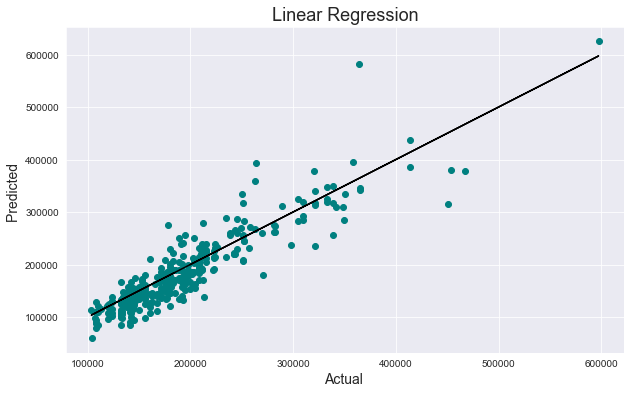

In [207]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='teal')
plt.plot(pred_test,pred_test,color='black')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Gradient Boosting

In [208]:
from sklearn.ensemble import GradientBoostingRegressor
gbr=GradientBoostingRegressor()

#training_Gradient_Boost
gbr.fit(x_train,y_train)
gbr_score= gbr.score(x_train,y_train)

#predict_gbr
pred_train = gbr.predict(x_train)
pred_test = gbr.predict(x_test)

#result_gbr
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  0.9727803450159803 Testing Accuracy R2_score  0.8995326711612333
Training Mean_squared_Error  179098564.6427487 Testing Mean_squared_error  549922419.8427321
Training Absolute_Error  9973.128999099741 Testing Absolute Error 15991.996240673408


In [210]:
from sklearn.model_selection import cross_val_score

# testing
train_accuracy=r2_score(y_train,pred_train)
test_accuracy =r2_score(y_test,pred_test)

#cross validation
for i in range(2,10):
    gbr_cv_score=cross_val_score(gbr,x,y,cv=i)
    cv_mean=gbr_cv_score.mean()
    
    print(f"At CROSS_FOLD{i}, Cross_Val_Score is {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD2, Cross_Val_Score is 0.8414192371685365 ,Training Score is 0.9727803450159803,Testing Score0.8995326711612333
At CROSS_FOLD3, Cross_Val_Score is 0.878566282895629 ,Training Score is 0.9727803450159803,Testing Score0.8995326711612333
At CROSS_FOLD4, Cross_Val_Score is 0.8361206581447751 ,Training Score is 0.9727803450159803,Testing Score0.8995326711612333
At CROSS_FOLD5, Cross_Val_Score is 0.8650066813200926 ,Training Score is 0.9727803450159803,Testing Score0.8995326711612333
At CROSS_FOLD6, Cross_Val_Score is 0.8587738776772734 ,Training Score is 0.9727803450159803,Testing Score0.8995326711612333
At CROSS_FOLD7, Cross_Val_Score is 0.852586822900876 ,Training Score is 0.9727803450159803,Testing Score0.8995326711612333
At CROSS_FOLD8, Cross_Val_Score is 0.8654035682638868 ,Training Score is 0.9727803450159803,Testing Score0.8995326711612333
At CROSS_FOLD9, Cross_Val_Score is 0.8589480075271009 ,Training Score is 0.9727803450159803,Testing Score0.8995326711612333


In [211]:
# pred training for Gradient Boost
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

#cross val with Gradient Boost
gbr_cv_score=cross_val_score(gbr,x,y,cv=3) 
gbr_mean=gbr_cv_score.mean() # mean value

print("Cv_score of Model is ",gbr_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.8787103839121818  The Training Score is 0.9727803450159803 Testing Score Stands  0.8995326711612333


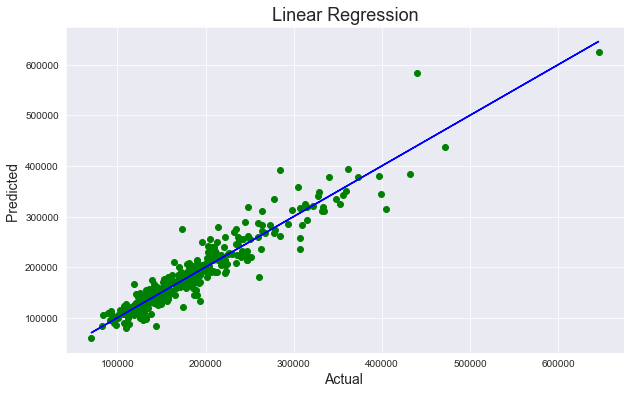

In [212]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='green')
plt.plot(pred_test,pred_test,color='blue')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Neural Networks

## MLP Regressor

In [213]:
from sklearn.neural_network import MLPRegressor
mlp= MLPRegressor()

#training
#training_mlp
mlp.fit(x_train,y_train)
mlp_score= mlp.score(x_train,y_train)

#predict_mlp
pred_train = mlp.predict(x_train)
pred_test = mlp.predict(x_test)

#result_mlp
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  -4.819801200970982 Testing Accuracy R2_score  -6.122675214533063
Training Mean_squared_Error  38292845453.47771 Testing Mean_squared_error  38986990447.570015
Training Absolute_Error  178481.52621037027 Testing Absolute Error 183420.02493562092


In [214]:
from sklearn.model_selection import cross_val_score

# testing
train_accuracy=r2_score(y_train,pred_train)
test_accuracy =r2_score(y_test,pred_test)

#cross validation
for i in range(2,10):
    mlp_cv_score=cross_val_score(mlp,x,y,cv=i)
    cv_mean=mlp_cv_score.mean()
    
    print(f"At CROSS_FOLD{i}, Cross_Val_Score is {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD2, Cross_Val_Score is -5.244709958600686 ,Training Score is -4.819801200970982,Testing Score-6.122675214533063
At CROSS_FOLD3, Cross_Val_Score is -5.2464824978872695 ,Training Score is -4.819801200970982,Testing Score-6.122675214533063
At CROSS_FOLD4, Cross_Val_Score is -5.268008558272922 ,Training Score is -4.819801200970982,Testing Score-6.122675214533063
At CROSS_FOLD5, Cross_Val_Score is -5.266745264044994 ,Training Score is -4.819801200970982,Testing Score-6.122675214533063
At CROSS_FOLD6, Cross_Val_Score is -5.246923033454007 ,Training Score is -4.819801200970982,Testing Score-6.122675214533063
At CROSS_FOLD7, Cross_Val_Score is -5.341213774072896 ,Training Score is -4.819801200970982,Testing Score-6.122675214533063
At CROSS_FOLD8, Cross_Val_Score is -5.301367989261233 ,Training Score is -4.819801200970982,Testing Score-6.122675214533063
At CROSS_FOLD9, Cross_Val_Score is -5.3966241770113506 ,Training Score is -4.819801200970982,Testing Score-6.122675214533063


In [215]:
# pred training for MLP Regressor
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

#cross val with MLP Regressor
mlp_cv_score=cross_val_score(mlp,x,y,cv=5) 
mlp_mean=mlp_cv_score.mean() # mean value

print("Cv_score of Model is ",mlp_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  -5.273575093775131  The Training Score is -4.819801200970982 Testing Score Stands  -6.122675214533063


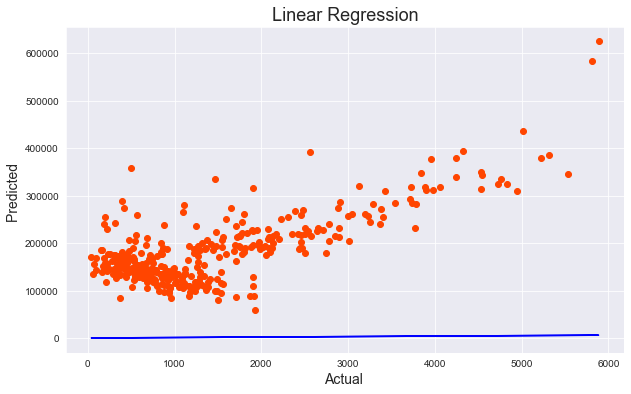

In [216]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='orangered')
plt.plot(pred_test,pred_test,color='blue')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Bagging Regressor

In [217]:
from sklearn.ensemble import BaggingRegressor
br= BaggingRegressor()

#training
#training_mlp
br.fit(x_train,y_train)
br_score= br.score(x_train,y_train)

#predict_mlp
pred_train = br.predict(x_train)
pred_test = br.predict(x_test)

#result_mlp
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_test))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_test))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_test))

Training Accuracy r2_score  0.9626264246805812 Testing Accuracy R2_score  0.8725400897226521
Training Mean_squared_Error  245908836.80212978 Testing Mean_squared_error  697670208.841168
Training Absolute_Error  8578.072949816402 Testing Absolute Error 17791.575783475782


In [218]:
from sklearn.model_selection import cross_val_score

#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

for i in range(2,10):
    br_cv_score=cross_val_score(br,x,y,cv=i)
    cv_mean=br_cv_score.mean()

    print(f"At CROSS_FOLD{i}, The Cross_Val_Score {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD2, The Cross_Val_Score 0.8080387112069929 ,Training Score is 0.9626264246805812,Testing Score0.8725400897226521
At CROSS_FOLD3, The Cross_Val_Score 0.823660604925006 ,Training Score is 0.9626264246805812,Testing Score0.8725400897226521
At CROSS_FOLD4, The Cross_Val_Score 0.8171296769650124 ,Training Score is 0.9626264246805812,Testing Score0.8725400897226521
At CROSS_FOLD5, The Cross_Val_Score 0.8218565227340277 ,Training Score is 0.9626264246805812,Testing Score0.8725400897226521
At CROSS_FOLD6, The Cross_Val_Score 0.8433381081028227 ,Training Score is 0.9626264246805812,Testing Score0.8725400897226521
At CROSS_FOLD7, The Cross_Val_Score 0.8177760002269493 ,Training Score is 0.9626264246805812,Testing Score0.8725400897226521
At CROSS_FOLD8, The Cross_Val_Score 0.8414374756865746 ,Training Score is 0.9626264246805812,Testing Score0.8725400897226521
At CROSS_FOLD9, The Cross_Val_Score 0.8334208013644928 ,Training Score is 0.9626264246805812,Testing Score0.8725400897226521


In [220]:
# pred training for Random Forest
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

#cross val with Random Forest
br_cv_score=cross_val_score(br,x,y,cv=8) 
br_mean=br_cv_score.mean()

print("Cv_score of Model is ",br_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.8265587552655669  The Training Score is 0.9626264246805812 Testing Score Stands  0.8725400897226521


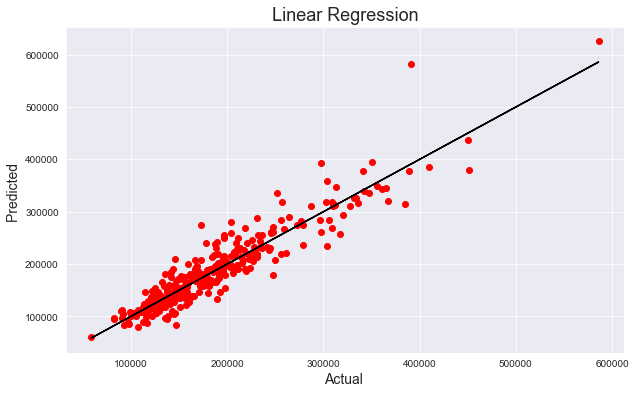

In [221]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_test,y=y_test,color='red')
plt.plot(pred_test,pred_test,color='black')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

## Using Hyper-Parameter on the Selected Model

      - Model-1. Random Forest Regressor
      - Model-2. Gradient Boosting Regressor
      

- Selected Both Models as cross validation score is better along with Training Score and Testing Score. 
- "MSE" and "MAE" are less on compare to other models.(They are close to the mean)
- Overall Model selection is based on cv_score is higher and training score is close to the cv_score.

# Model- 1: Random Forest Regressor With Grid Search CV

In [231]:
from sklearn.model_selection import GridSearchCV

parameters={'n_estimators':[100,104,],
           'criterion':['mse', 'mae'],
           'min_samples_leaf':[1,2,3],
            'random_state':[39],
           'max_features':['auto','sqrt','log2']}

gsv=GridSearchCV(rfr,parameters,cv=3)
gsv.fit(x_train,y_train)

print("Best Parameter ",gsv.best_params_,"Best Score ",gsv.best_score_)

Best Parameter  {'criterion': 'mae', 'max_features': 'log2', 'min_samples_leaf': 1, 'n_estimators': 104} Best Score  0.8099954664075724


In [288]:
rfr=RandomForestRegressor(n_estimators=104,criterion='mae',min_samples_leaf=1,max_features='log2',min_weight_fraction_leaf=0.0001,
                         min_impurity_decrease=0.00000001,n_jobs=1,ccp_alpha=0.00000001)

#training Random Forest
rfr.fit(x_train,y_train)
rfr_score= rfr.score(x_train,y_train)

#predict Model
pred_train = rfr.predict(x_train)
pred_result1 = rfr.predict(x_test)

#result
print("Training Accuracy r2_score ",r2_score(y_train,pred_train),"Testing Accuracy R2_score ",r2_score(y_test,pred_result1))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_result1))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train),"Testing Absolute Error",mean_absolute_error(y_test,pred_result1))

Training Accuracy r2_score  0.9781933947266256 Testing Accuracy R2_score  0.8943292796773769
Training Mean_squared_Error  143482042.9019122 Testing Mean_squared_error  578403933.8758519
Training Absolute_Error  6944.253295358253 Testing Absolute Error 15174.957538899846


In [289]:
#training accuracy.
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_result1)

for i in range(2,20):
    rfr_cv_score=cross_val_score(rfr,x,y,cv=i)
    cv_mean=rfr_cv_score.mean()

    print(f"At CROSS_FOLD{i}, The Cross_Val_Score {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD2, The Cross_Val_Score 0.8395408590998447 ,Training Score is 0.9781933947266256,Testing Score0.8943292796773769
At CROSS_FOLD3, The Cross_Val_Score 0.8549649229102846 ,Training Score is 0.9781933947266256,Testing Score0.8943292796773769
At CROSS_FOLD4, The Cross_Val_Score 0.837721067166574 ,Training Score is 0.9781933947266256,Testing Score0.8943292796773769
At CROSS_FOLD5, The Cross_Val_Score 0.8411419583603325 ,Training Score is 0.9781933947266256,Testing Score0.8943292796773769
At CROSS_FOLD6, The Cross_Val_Score 0.853588727652221 ,Training Score is 0.9781933947266256,Testing Score0.8943292796773769
At CROSS_FOLD7, The Cross_Val_Score 0.8471084641592721 ,Training Score is 0.9781933947266256,Testing Score0.8943292796773769
At CROSS_FOLD8, The Cross_Val_Score 0.8531316700736595 ,Training Score is 0.9781933947266256,Testing Score0.8943292796773769
At CROSS_FOLD9, The Cross_Val_Score 0.8482446010026076 ,Training Score is 0.9781933947266256,Testing Score0.8943292796773769
At

In [290]:
# pred training for Extra Trees
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_result1)

#cross val with Extra Trees
rfr_cv_score=cross_val_score(rfr,x,y,cv=3) 
rfr_mean=rfr_cv_score.mean() #mean value

print("Cv_score of Model is ",rfr_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.8574957011950265  The Training Score is 0.9781933947266256 Testing Score Stands  0.8943292796773769


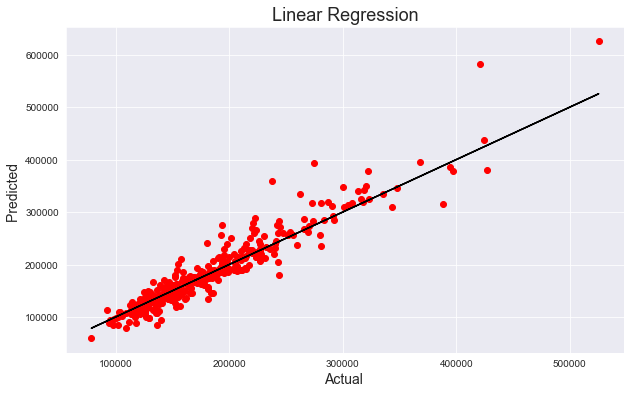

In [292]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_result1,y=y_test,color='red')
plt.plot(pred_result1,pred_result1,color='black')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Model 2: Gradient Boosting Regressor with Grid Search CV

In [293]:
from sklearn.ensemble import GradientBoostingRegressor
gbr=GradientBoostingRegressor()
parameters={ 'loss':['squared_error', 'absolute_error', 'huber', 'quantile'],
            'learning_rate':[0.1,0.2,0.3],
            'n_estimators':[100,102,104],
            'ccp_alpha':[0.00000001],
           'criterion':['friedman_mse', 'squared_error', 'mse'],
           'max_features':['auto', 'sqrt', 'log2']}

gsv=GridSearchCV(gbr,parameters,cv=3)
gsv.fit(x_train,y_train)

print("Best Parameter ",gsv.best_params_,"Best Score ",gsv.best_score_)

Best Parameter  {'ccp_alpha': 1e-08, 'criterion': 'squared_error', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_features': 'log2', 'n_estimators': 102} Best Score  0.8302688263536596


In [360]:
gbr=GradientBoostingRegressor(ccp_alpha=1e-08, criterion= 'squared_error', learning_rate= 0.1, loss= 'squared_error', max_features= 'log2',
                              n_estimators= 102,random_state=39)

#training_Gradient_Boost
gbr.fit(x_train,y_train)
gbr_score= gbr.score(x_train,y_train)

#predict_gbr
pred_train2 = gbr.predict(x_train)
pred_result2 = gbr.predict(x_test)

#result_gbr
print("Training Accuracy r2_score ",r2_score(y_train,pred_train2),"Testing Accuracy R2_score ",r2_score(y_test,pred_result2))
print("Training Mean_squared_Error ",mean_squared_error(y_train,pred_train2),"Testing Mean_squared_error ",mean_squared_error(y_test,pred_result2))
print("Training Absolute_Error ",mean_absolute_error(y_train,pred_train2),"Testing Absolute Error",mean_absolute_error(y_test,pred_result2))

Training Accuracy r2_score  0.9645647221083257 Testing Accuracy R2_score  0.8961445983776037
Training Mean_squared_Error  233155321.4705225 Testing Mean_squared_error  568467525.055661
Training Absolute_Error  11298.597099804498 Testing Absolute Error 15883.094238070278


In [361]:
#training accuracy.
train_accuracy=r2_score(y_train,pred_train2)
test_accuracy=r2_score(y_test,pred_result2)

for i in range(2,10):
    gbr_cv_score=cross_val_score(gbr,x,y,cv=i)
    cv_mean=gbr_cv_score.mean()

    print(f"At CROSS_FOLD {i}, The Cross_Val_Score {cv_mean} ,Training Score is {train_accuracy},Testing Score{test_accuracy}")

At CROSS_FOLD 2, The Cross_Val_Score 0.8511737266328665 ,Training Score is 0.9645647221083257,Testing Score0.8961445983776037
At CROSS_FOLD 3, The Cross_Val_Score 0.8778677003638116 ,Training Score is 0.9645647221083257,Testing Score0.8961445983776037
At CROSS_FOLD 4, The Cross_Val_Score 0.8436997227338479 ,Training Score is 0.9645647221083257,Testing Score0.8961445983776037
At CROSS_FOLD 5, The Cross_Val_Score 0.868733690527626 ,Training Score is 0.9645647221083257,Testing Score0.8961445983776037
At CROSS_FOLD 6, The Cross_Val_Score 0.8725532160440949 ,Training Score is 0.9645647221083257,Testing Score0.8961445983776037
At CROSS_FOLD 7, The Cross_Val_Score 0.8515695357555954 ,Training Score is 0.9645647221083257,Testing Score0.8961445983776037
At CROSS_FOLD 8, The Cross_Val_Score 0.8656171854063857 ,Training Score is 0.9645647221083257,Testing Score0.8961445983776037
At CROSS_FOLD 9, The Cross_Val_Score 0.8540049263159414 ,Training Score is 0.9645647221083257,Testing Score0.8961445983

## Slected cross fold 3 as Training score is close to Testing score

In [362]:
# pred training for Gradient Boost
train_accuracy=r2_score(y_train,pred_train2)
test_accuracy=r2_score(y_test,pred_result2)

#cross val with Gradient Boost
gbr_cv_score=cross_val_score(gbr,x,y,cv=3) 
gbr_mean=gbr_cv_score.mean() # mean value

print("Cv_score of Model is ",gbr_mean," The Training Score is", train_accuracy,"Testing Score Stands " ,test_accuracy)

Cv_score of Model is  0.8778677003638116  The Training Score is 0.9645647221083257 Testing Score Stands  0.8961445983776037


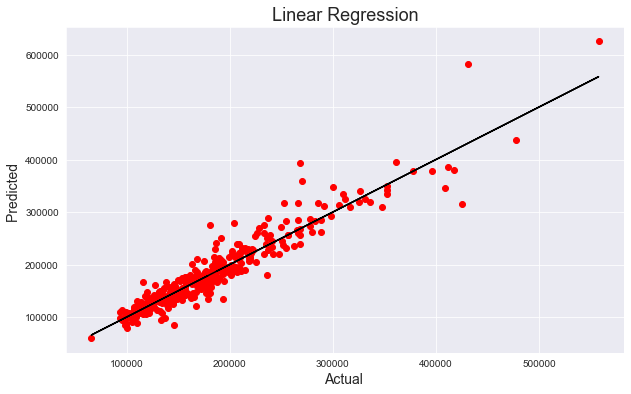

In [363]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_result2,y=y_test,color='red')
plt.plot(pred_result2,pred_result2,color='black')
plt.xlabel('Actual ',fontsize=14)
plt.ylabel('Predicted ',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

# Regularization

In [365]:
from sklearn.linear_model import Lasso
ls=Lasso()
parameters={ 'alpha':[1.0,10,0.01,0.001,0.0001,0.00001,0.000001],
            'max_iter':[1000,2000,3000,4000,5000],
            'tol':[1e-4,1e-5,1e-3],
            'random_state':[39]}

gsv=GridSearchCV(ls,parameters,cv=3)
gsv.fit(x_train,y_train)

print("Best Parameter ",gsv.best_params_,"Best Score ",gsv.best_score_)

Best Parameter  {'alpha': 10, 'max_iter': 1000, 'random_state': 39, 'tol': 1e-05} Best Score  0.6999885360997373


In [368]:
from sklearn.linear_model import Ridge
rd=Ridge()

parameters={'alpha':[1.0,10,0.01,0.001,0.0001,0.00001,0.000001],
           'tol':[1e-3,1e-4,1e-5,1e-6,1e-7],
           'solver':['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga', 'lbfgs'],
           'random_state':[39]}

gsv=GridSearchCV(rd,parameters,cv=3)
gsv.fit(x_train,y_train)

print("Best Parameter ",gsv.best_params_,"Best Score ",gsv.best_score_)

Best Parameter  {'alpha': 10, 'random_state': 39, 'solver': 'saga', 'tol': 0.001} Best Score  0.7123010695729715


In [369]:
from sklearn.linear_model import ElasticNet
en=ElasticNet()

parameters={'alpha':[1.0,10,0.01,0.001,0.0001,0.00001,0.000001],
            'l1_ratio':[0.5,0.6,0.7,0.4],
            'max_iter':[1000,2000,3000,4000,5000],
           'tol':[1e-4,1e-5,1e-6,1e-7,1e-8,1e-9,1e-10],
           'selection':['cyclic', 'random'],
           'random_state':[39]}

gsv=GridSearchCV(en,parameters,cv=3)
gsv.fit(x_train,y_train)

print("Best Parameter ",gsv.best_params_,"Best Score ",gsv.best_score_)

Best Parameter  {'alpha': 1.0, 'l1_ratio': 0.5, 'max_iter': 1000, 'random_state': 39, 'selection': 'cyclic', 'tol': 0.0001} Best Score  0.7560969109232696


# Saving Model

Selected this model as its:

- R2 Score is better for the model.
- CV Score better for these model they are nearer to training score.
- "MSE" and "MAE" are less on compare to other models.(They are close to the mean)

In [372]:
import pickle
filename="US_Housepred.pkl"
pickle.dump(gbr, open(filename, 'wb'))

In [373]:
import pickle
model = pickle.load(open('US_Housepred.pkl', 'rb'))
result=model.score(x_test,y_test)
print(result*100)

89.61445983776038


In [374]:
new_df1=pd.DataFrame([model.predict(x_test)[:],pred_result2[:]],index=["Predicted","Original"])
new_df1

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350
Predicted,178734.614991,117861.121183,136739.776622,134517.493599,267682.469578,194669.675165,98886.876706,186346.266607,165968.455522,282311.369067,196802.189105,121109.288337,158356.530561,157922.233,326329.796743,143100.289902,181247.781741,98637.505094,417560.153816,197448.117202,202806.995124,173332.209326,147797.708942,128841.803768,156790.398761,189766.779204,190550.87096,193534.387971,278227.561686,291597.297828,361665.485058,131681.71185,121299.115307,175670.045744,251847.189667,98895.058209,256820.581178,219863.10502,105385.583916,118008.246368,148759.40741,128100.964504,156239.891286,129632.423854,168973.477034,190183.013916,108225.544181,93922.296984,268495.621002,209094.076927,113489.558602,209858.661205,218608.390229,225262.544794,232740.151155,123482.307269,177070.037667,177049.131219,134172.059085,252869.29557,254841.160847,156359.980139,236220.510368,208922.187164,192557.503575,149536.028256,557852.371021,316552.413081,108511.057129,204023.547481,377331.954336,335917.869819,185439.463908,131906.599821,214309.310115,163903.721394,144913.776275,159501.791108,179622.389553,236824.593714,145282.424445,177677.519578,206290.51186,288310.465501,120427.292432,166132.706526,219526.4318,179179.515455,201285.321946,408755.306995,122422.992167,162101.302688,128844.084097,114678.707321,133316.79429,139944.219127,194175.211591,249683.94186,99915.138225,154371.209288,144065.450422,159093.398473,167104.657379,224494.167534,168024.232953,325647.069736,218276.260556,188512.199063,110308.978511,107216.070058,146462.513412,221640.798529,188039.417487,347636.135952,186805.938078,160421.503617,185474.001913,97462.712332,115003.318709,111617.797677,212071.456234,110050.67434,125158.361494,156744.862711,193179.392627,256356.680487,396368.283039,147109.781826,217862.893541,299740.474686,132198.232438,235028.268939,206509.621543,168104.8384,161843.374744,201575.104865,147137.40885,208836.511804,120629.197807,217617.388505,151255.928405,118453.133268,209756.659263,198664.556785,352210.588423,170618.219504,188279.481522,127184.938899,143936.34699,179123.784994,172143.197674,228468.702562,151674.991701,151108.496223,126841.962637,119262.709419,191620.263133,108773.963328,143519.372871,168365.198376,162964.908822,141051.413282,173088.346704,204575.817609,134855.197177,105591.634505,285604.205168,202825.561172,159718.779894,139166.727286,135843.958077,210891.180197,161636.302716,186663.111437,132751.046298,98574.931041,133094.041487,186548.619754,153728.352527,184205.419961,247804.731737,173446.227633,145660.275443,115365.123745,121285.392562,185910.641294,167711.367419,265909.235721,115885.612242,198802.495702,144072.012567,265917.27134,187619.117492,131703.95381,141992